<a href="https://colab.research.google.com/github/ZofiaSamsel/P300_speller_machine_learning_classification/blob/main/grupa_p300_speller.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install MNE

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 44.9 MB/s eta 0:00:00


In [ ]:
!pip install autoreject

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.4/9.4 MB 28.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 300.0/300.0 KB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 965.4/965.4 KB 24.3 MB/s eta 0:00:00
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2


In [ ]:
!pip install pymatreader

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import re
import sys
import ast
import os.path as op
from collections import defaultdict
from copy import deepcopy
import copy

import mne
import pymatreader
import numpy as np
import pandas as pd
import matplotlib
import glob


import pickle
import scipy
from numpy import genfromtxt
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import csv


from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn import set_config
from sklearn.model_selection import cross_val_score
from sklearn.decomposition import PCA
from sklearn.model_selection import KFold
from sklearn.feature_selection import SelectKBest, SelectPercentile, f_regression, SelectFpr, SelectFdr, SequentialFeatureSelector
from sklearn.model_selection import GridSearchCV
from sklearn.base import TransformerMixin, BaseEstimator
from sklearn import datasets, linear_model
from sklearn.pipeline import make_pipeline
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics

from mne.io import RawArray
from mne.channels import read_custom_montage
from mne.epochs import concatenate_epochs
from mne import create_info, find_events, Epochs
from mne.decoding import CSP
from mne import pick_types
from mne.decoding import UnsupervisedSpatialFilter
from mne.decoding import Vectorizer

from scipy.signal import welch

from autoreject import get_rejection_threshold
from autoreject import AutoReject

warnings.filterwarnings("ignore")

sns.set_theme(style="whitegrid", palette="deep")

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!ls gdrive/MyDrive/ML/train

ChannelsLocation.csv  Data_S13_Sess01.csv  Data_S20_Sess04.csv
data.pkl	      Data_S13_Sess02.csv  Data_S20_Sess05.csv
Data_S02_Sess01.csv   Data_S13_Sess03.csv  Data_S21_Sess01.csv
Data_S02_Sess02.csv   Data_S13_Sess04.csv  Data_S21_Sess02.csv
Data_S02_Sess03.csv   Data_S13_Sess05.csv  Data_S21_Sess03.csv
Data_S02_Sess04.csv   Data_S14_Sess01.csv  Data_S21_Sess04.csv
Data_S02_Sess05.csv   Data_S14_Sess02.csv  Data_S21_Sess05.csv
Data_S06_Sess01.csv   Data_S14_Sess03.csv  Data_S22_Sess01.csv
Data_S06_Sess02.csv   Data_S14_Sess04.csv  Data_S22_Sess02.csv
Data_S06_Sess03.csv   Data_S14_Sess05.csv  Data_S22_Sess03.csv
Data_S06_Sess04.csv   Data_S16_Sess01.csv  Data_S22_Sess04.csv
Data_S06_Sess05.csv   Data_S16_Sess02.csv  Data_S22_Sess05.csv
Data_S07_Sess01.csv   Data_S16_Sess03.csv  Data_S23_Sess01.csv
Data_S07_Sess02.csv   Data_S16_Sess04.csv  Data_S23_Sess02.csv
Data_S07_Sess03.csv   Data_S16_Sess05.csv  Data_S23_Sess03.csv
Data_S07_Sess04.csv   Data_S17_Sess01.csv  Data_S23_Sess04.csv

In [ ]:
fnames = glob.glob('gdrive/MyDrive/ML/train/Data_S*.csv')
sfreq = 200

## **Wczytanie i preprocessing danych**
**Wczytanie danych:**


*   wczytanie danych z pliku .csv
*   indeksowanie danych po plikach (sesja_osoba)
*   eeg_data ma wszystkie informacje z indeksem i czasem, eeg_raw_data ma informacje bez czasu
*   przypisanie typu kanałom (eeg lub eog)
*   tworzenie obiektu MNE info
*   skalowanie: zamiana V na μV
*   stworzenie obiektu MNE raw

**Preproprocessing danych:**
*   zamiana błędnych nazw kanałów (P08 -> PO8)
*   wybór typu umieszczenia elektrod na głowie, wizualizacja
*   filtrowanie sygnału
*   tworzenie eventów
*   tworzenie epoch
*   odrzucanie złych epoch

In [ ]:
def preprocessing(fnames, info_filename=None,info="all"):

    for file in fnames:
      print(file)
      id = file[-14:-4]
      eeg_data = pd.read_csv(file)

      eeg_data['id']=id
      eeg_raw_data = eeg_data.copy()
      eeg_raw_data = eeg_raw_data.iloc[:,1:-1]

      ch_names = eeg_data.columns.to_numpy()[1:-1]

      ch_types = ['eeg']*len(ch_names)
      ch_types[-1] = 'eog'
      np.array(ch_types)



      info = mne.create_info(list(ch_names), sfreq=sfreq, ch_types=ch_types)

      eeg_raw_data_scaled = eeg_raw_data / 1000000

      raw = mne.io.RawArray(eeg_raw_data_scaled.T, info)    
      raw.info["ch_names"]

      channels_mat_new_names_dict = {
    'P08':'PO8',}

      raw.rename_channels(channels_mat_new_names_dict)

      montage = mne.channels.make_standard_montage('standard_1020')
      montage.plot()
      raw.set_montage(montage, match_case=False, on_missing='warn')

      #raw.compute_psd().plot() # no visible line noise

      nyquist_freq = raw.info["sfreq"] / 2
      #print(nyquist_freq)

      raw.notch_filter(freqs=np.arange(50, nyquist_freq, 50), picks='eeg')

      raw.filter(0.05, 25, method="iir", picks='eeg')

      fig = raw.plot(highpass=0.05, lowpass=25, duration=20, start=120)


      events_labels = pd.read_csv("gdrive/MyDrive/ML/train/TrainLabels.csv")

      Sub_Session_ID = file[29:-4]

      this_events_labels_df = events_labels[events_labels['IdFeedBack'].str.contains(Sub_Session_ID)]

      #print(this_events_labels_df)

      events_labels = this_events_labels_df["Prediction"].to_numpy()

      feedback_indexes = np.where(eeg_data.FeedBackEvent.to_numpy() == 1)[0]
      
      zeros_array = np.array([0]*len(feedback_indexes))
      
      this_events = np.column_stack([feedback_indexes, zeros_array, events_labels])
      
      event_dict = {'good': 1, 'bad': 0}

      epoch_start = -0.1
      epoch_stop = 0.6
      epochs = mne.Epochs(
          raw, 
          this_events, 
          event_id=event_dict,
          tmin=epoch_start,
          tmax=epoch_stop,
          baseline=None,
          preload=True,
          picks=['eeg', 'eog'] # if you have eog channels in your data, ALWAYS read them !
)

      fig = epochs.plot(n_epochs=2)

      epochs.apply_baseline(baseline=(-0.1, 0.6)) #tu mozna dac (-0.1, 0.0)

      reject_criteria = get_rejection_threshold(epochs, decim = 2) 

      epochs.drop_bad(reject = reject_criteria)

      fig = epochs.plot_drop_log()
      fig = epochs.plot(n_epochs=10, n_channels=64)

      #filename = 'gdrive/MyDrive/PLOTS/' + id +'plot.png'
      #fig.savefig(filename)

      dir_with_data = 'gdrive/MyDrive/FIFY/' # path to your data dir, eg. "data/" Remember the slash after the dir name !
      sub_id = file[29:-4] #split stringa po '/' (może zmienic)
      epochs.save(f"{dir_with_data}{sub_id}-epo.fif", overwrite=True)

gdrive/MyDrive/ML/train/Data_S02_Sess01.csv
Creating RawArray with float64 data, n_channels=58, n_times=132001
    Range : 0 ... 132000 =      0.000 ...   660.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


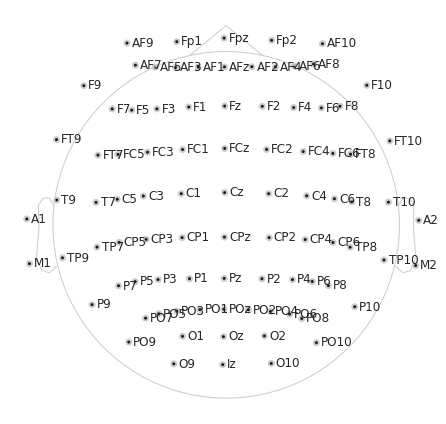

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.4s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB

Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB

Using matplotlib as 2D backend.


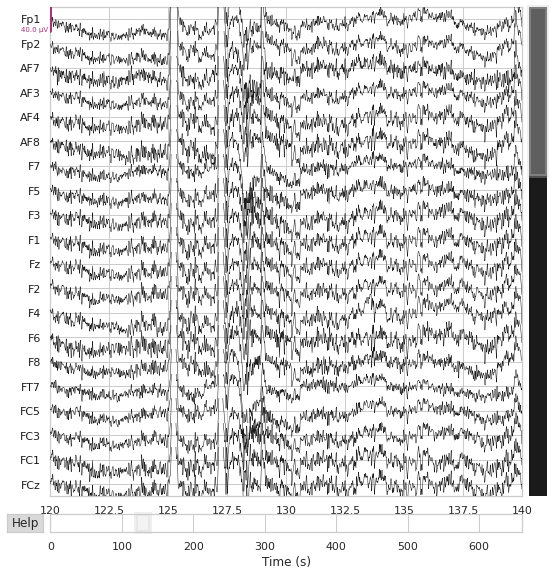

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


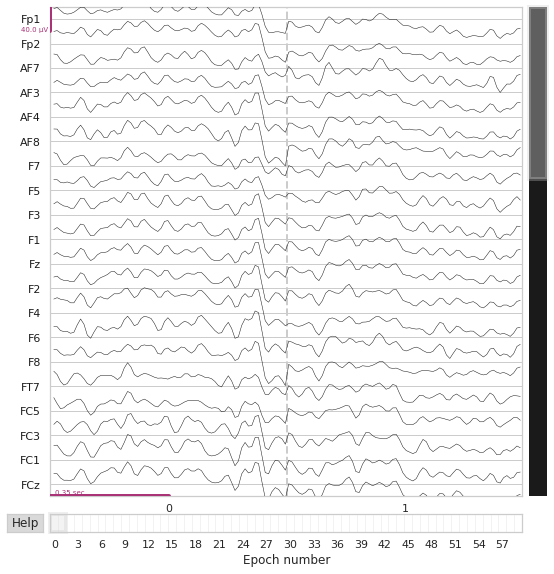

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'AF7', 'AF3', 'F5', 'F3', 'F1', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'CP3', 'CP1', 'CPz', 'CP2', 'CP6', 'P2', 'P6', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based o

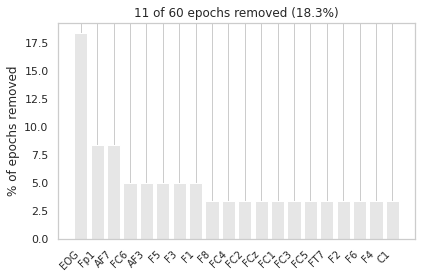

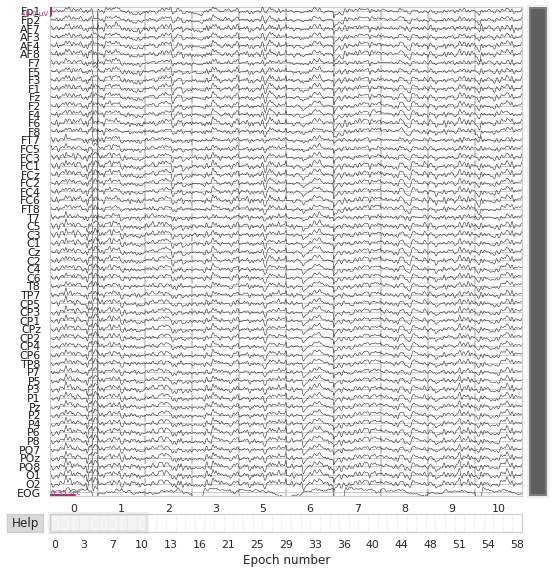

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S02_Sess02.csv
Creating RawArray with float64 data, n_channels=58, n_times=128001
    Range : 0 ... 128000 =      0.000 ...   640.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


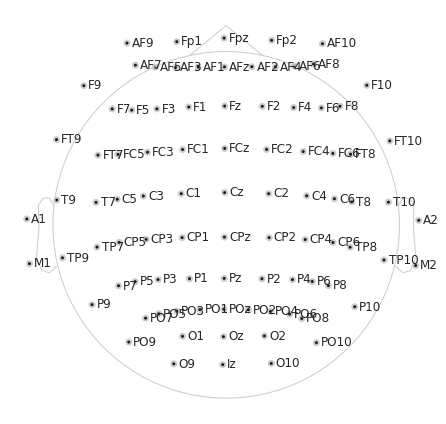

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



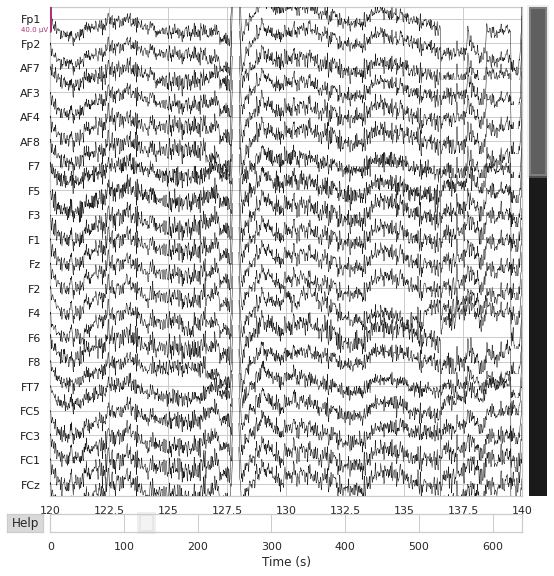

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


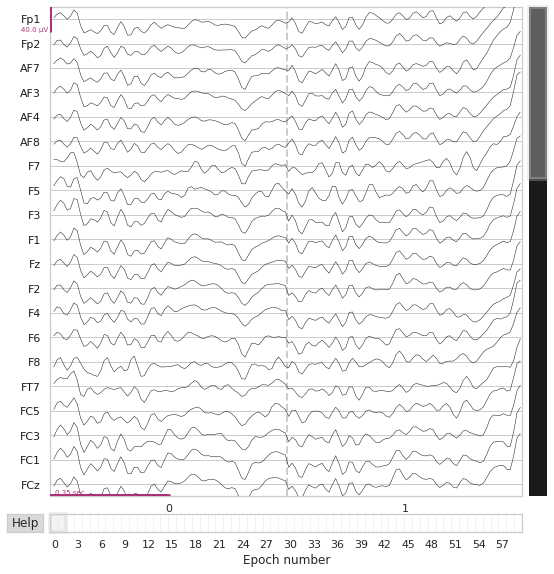

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['AF7']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F4', 'F6', 'F8', 'FC6', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'AF7', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'AF7', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
11 bad epochs dropped


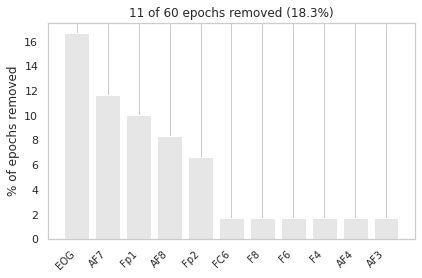

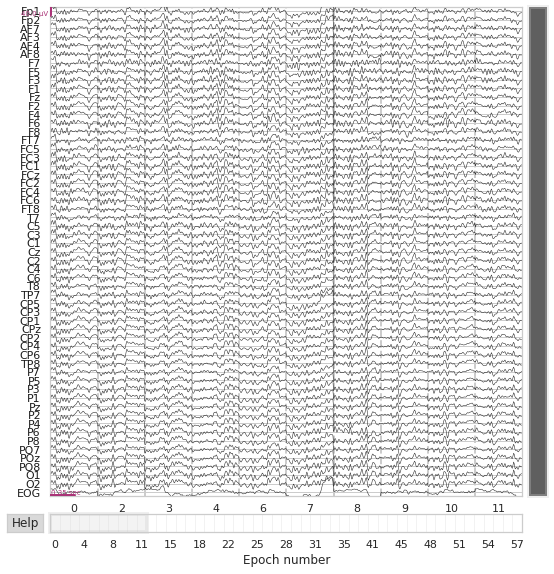

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S02_Sess03.csv
Creating RawArray with float64 data, n_channels=58, n_times=127001
    Range : 0 ... 127000 =      0.000 ...   635.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


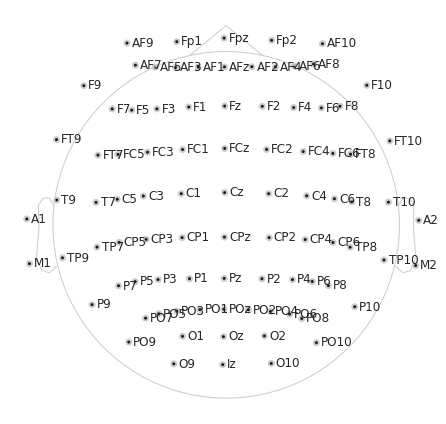

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



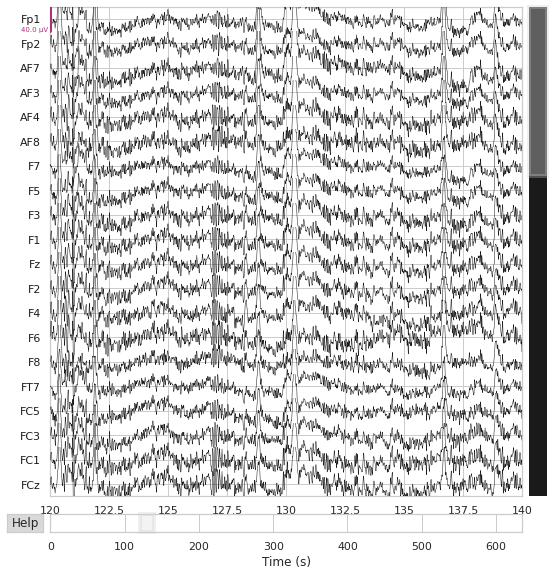

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


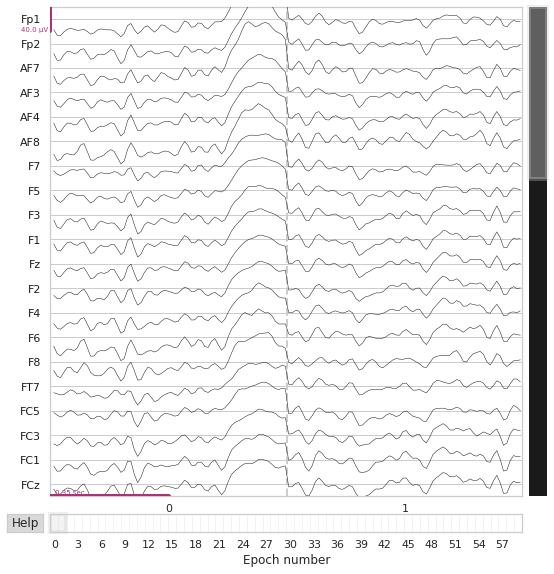

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
8 bad epochs dropped


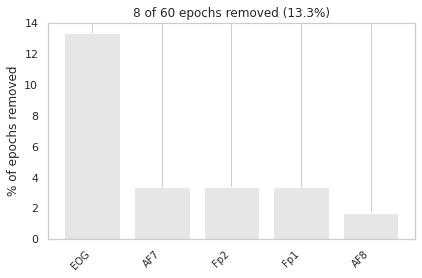

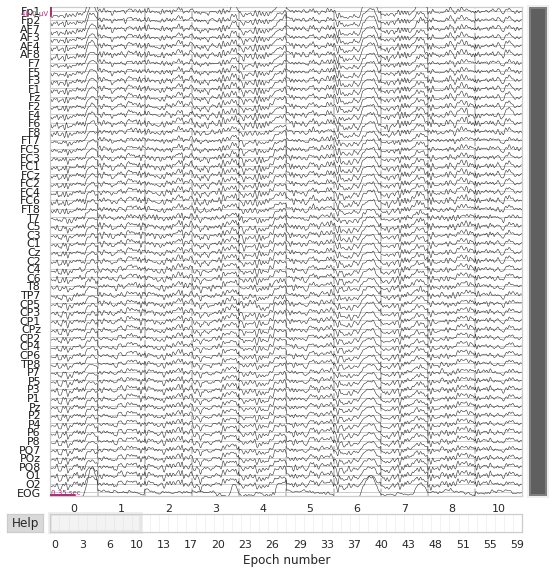

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S02_Sess04.csv
Creating RawArray with float64 data, n_channels=58, n_times=128001
    Range : 0 ... 128000 =      0.000 ...   640.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


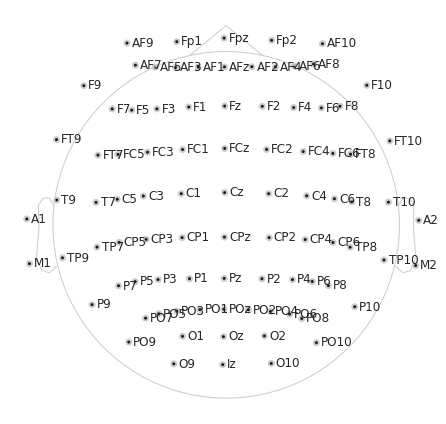

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



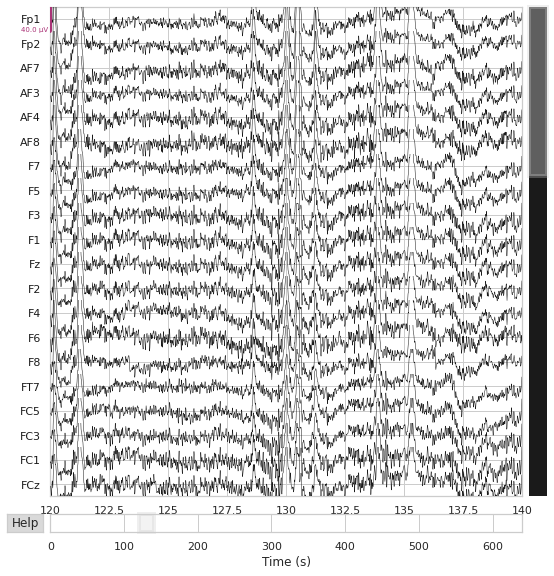

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


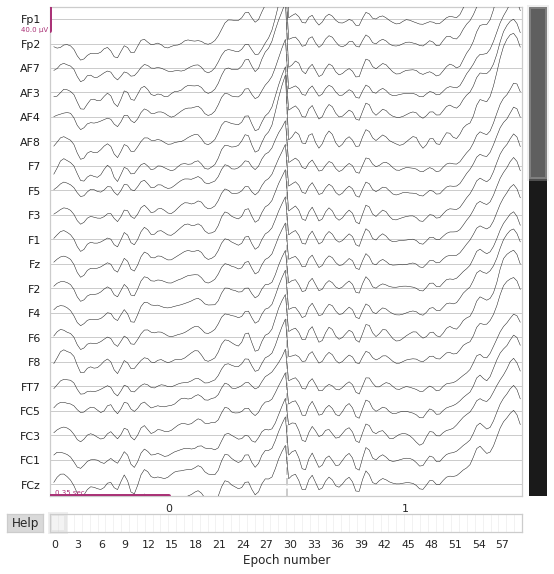

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
5 bad epochs dropped


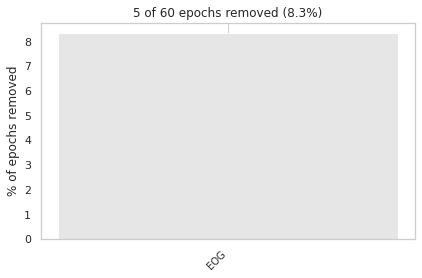

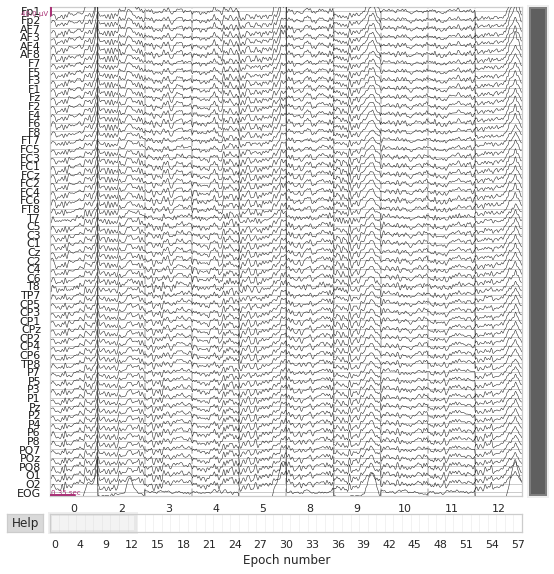

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S02_Sess05.csv
Creating RawArray with float64 data, n_channels=58, n_times=196001
    Range : 0 ... 196000 =      0.000 ...   980.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


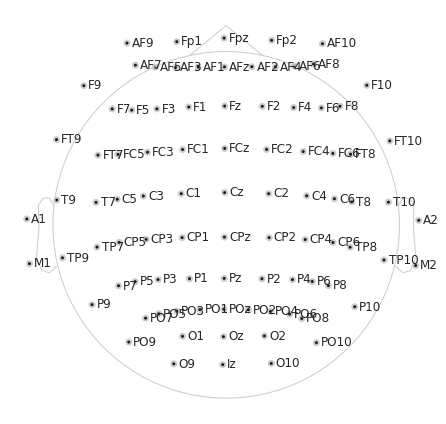

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.8s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



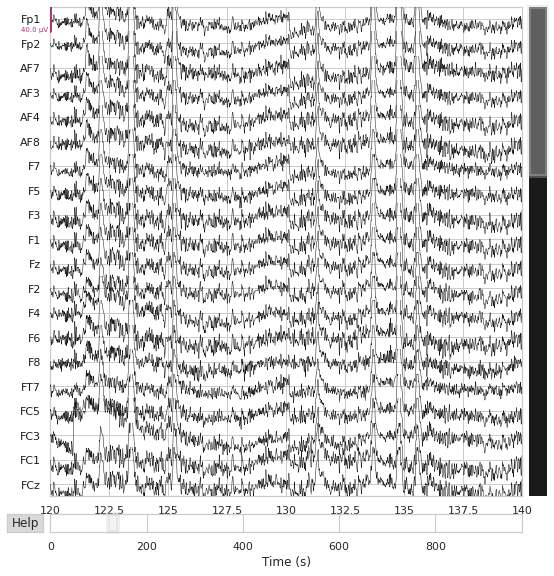

Not setting metadata
100 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 100 events and 141 original time points ...
0 bad epochs dropped


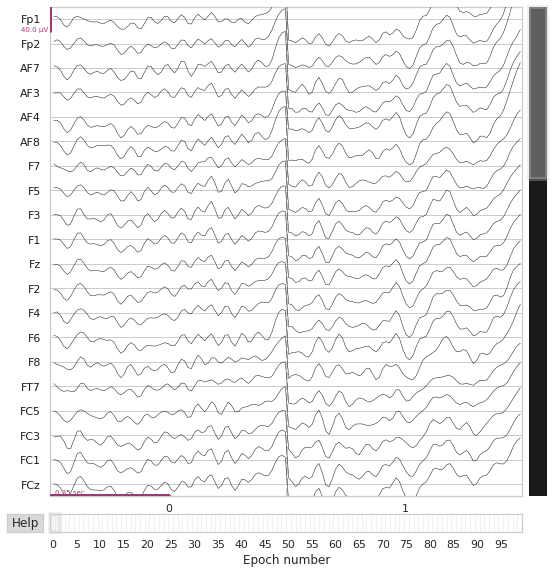

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
6 bad epochs dropped


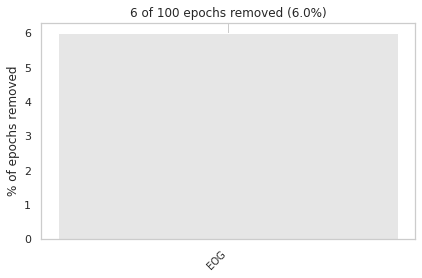

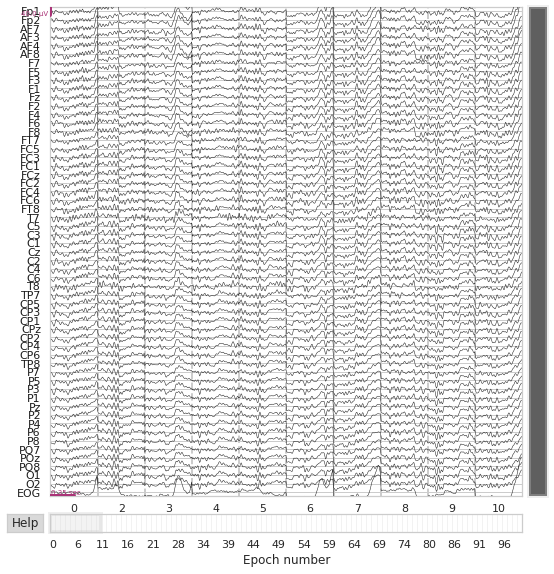

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S06_Sess01.csv
Creating RawArray with float64 data, n_channels=58, n_times=132001
    Range : 0 ... 132000 =      0.000 ...   660.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


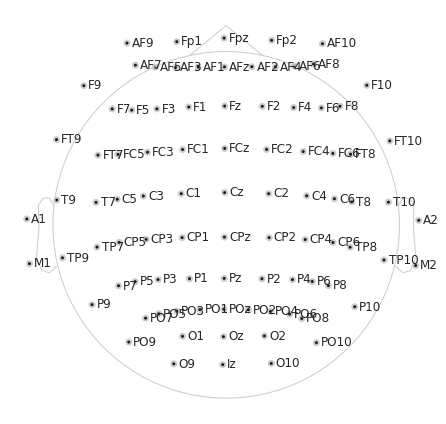

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



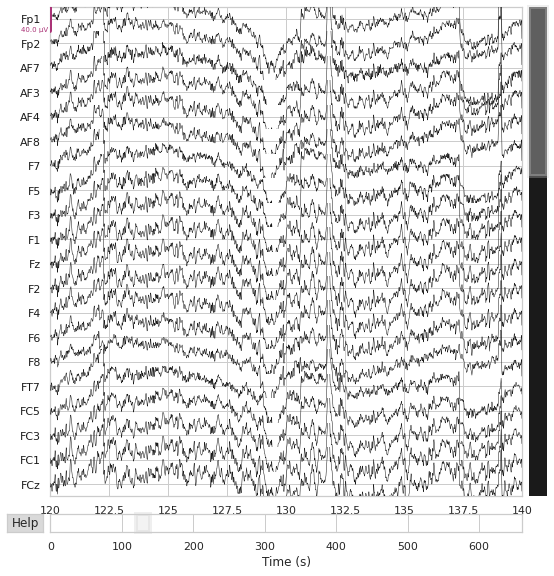

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


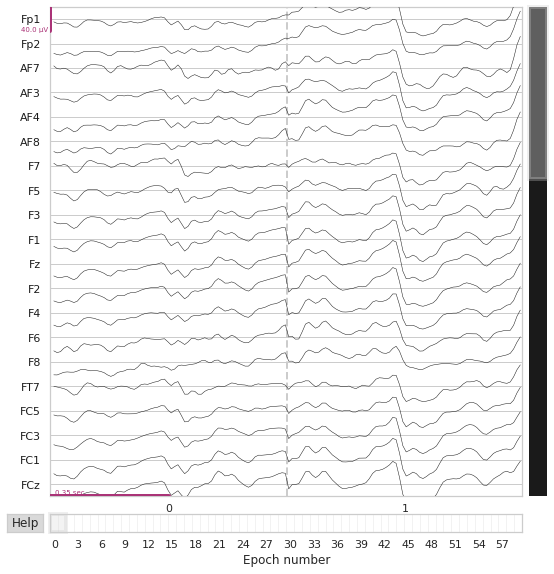

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'AF7', 'AF3', 'AF4', 'F5', 'F3', 'F1', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 

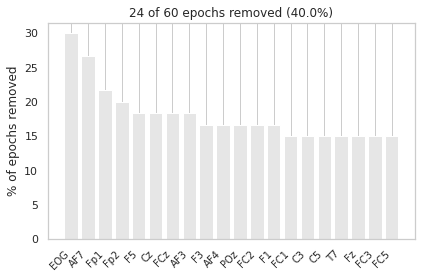

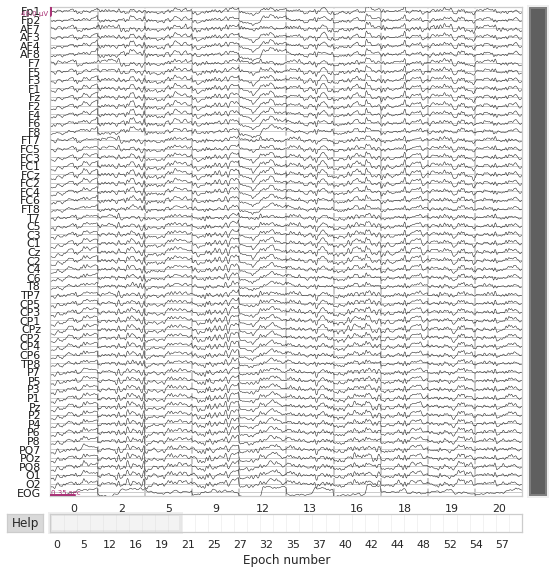

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S06_Sess02.csv
Creating RawArray with float64 data, n_channels=58, n_times=132601
    Range : 0 ... 132600 =      0.000 ...   663.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


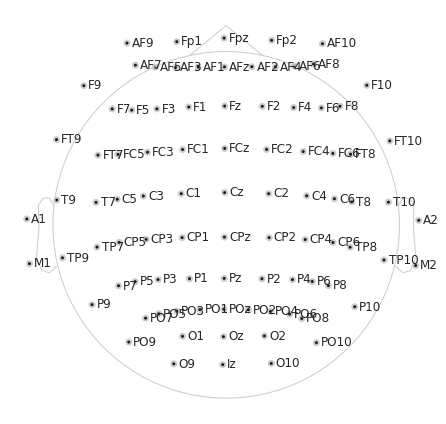

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



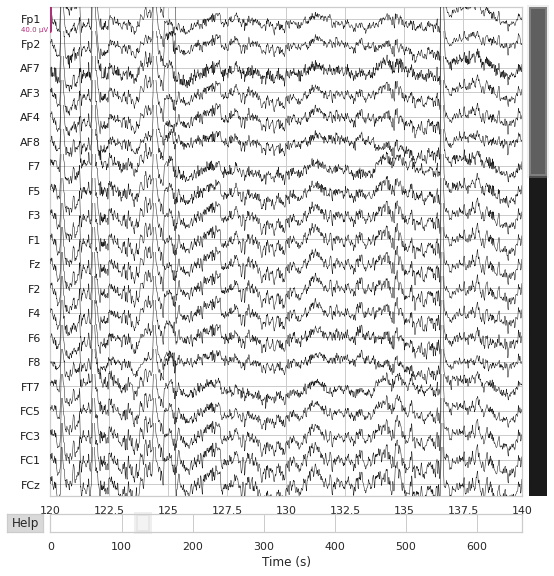

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


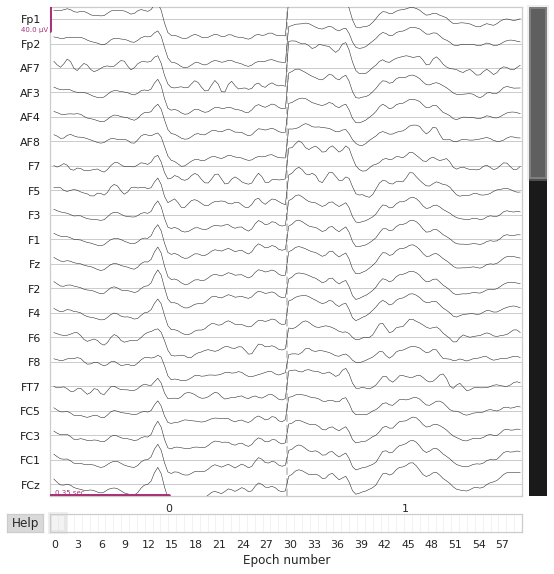

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['FC1', 'FCz', 'C3', 'C1', 'Cz', 'C2', 'CP3', 'CP1', 'CPz', 'CP2', 'P3', 'P1', 'Pz', 'P2']
    Rejecting  epoch based on EEG : ['AF7']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['AF7', 'FCz', 'C1', 'Cz']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'F

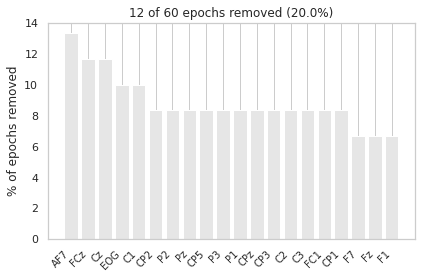

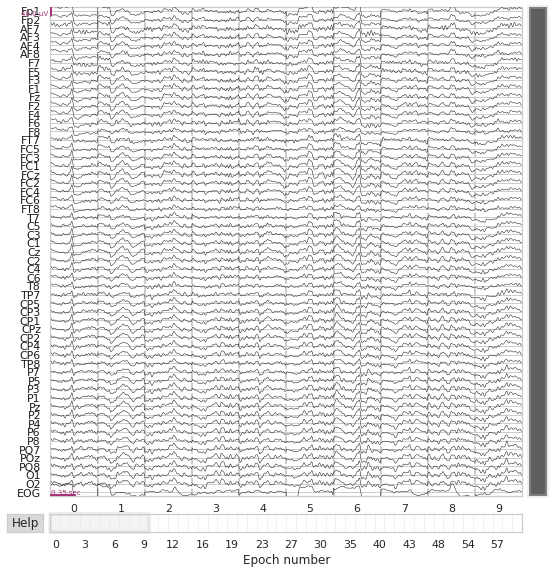

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S06_Sess03.csv
Creating RawArray with float64 data, n_channels=58, n_times=132601
    Range : 0 ... 132600 =      0.000 ...   663.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


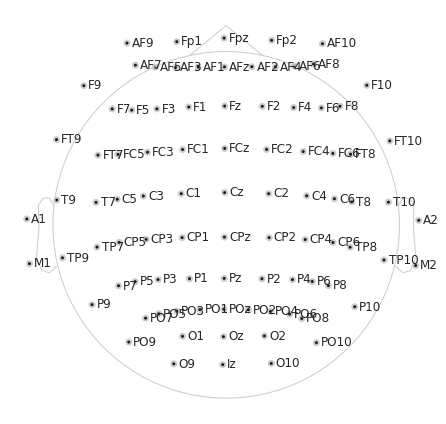

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



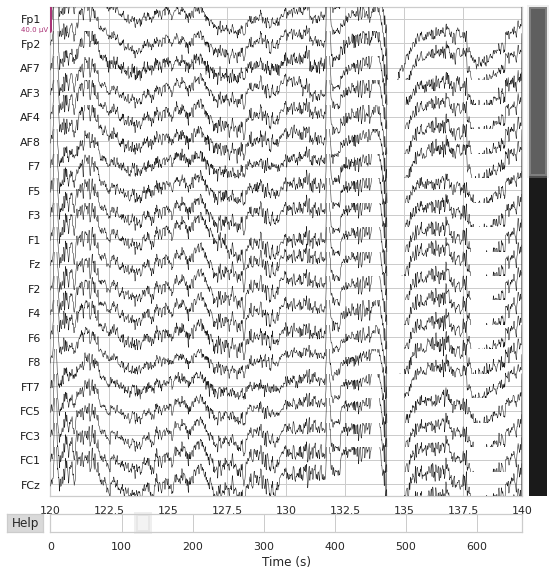

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


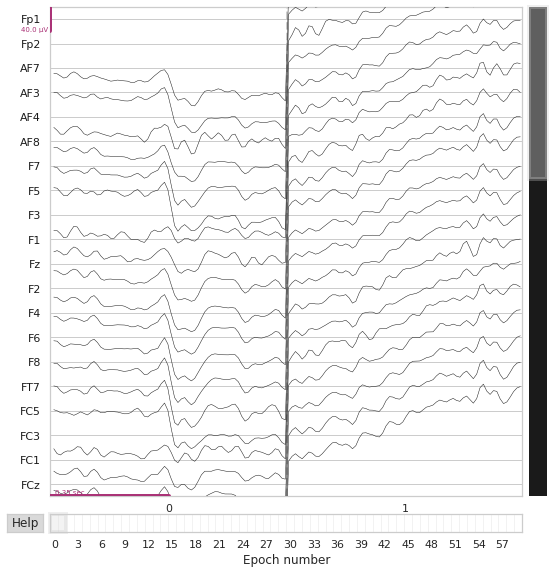

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp2', 'AF4', 'AF8', 'F2', 'F4', 'F6', 'F8', 'FCz', 'FC4', 'FC6', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', '

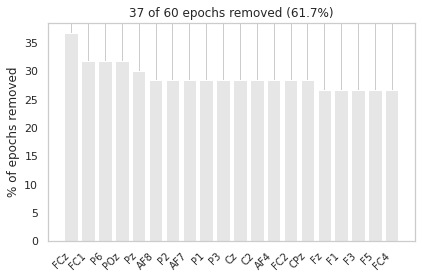

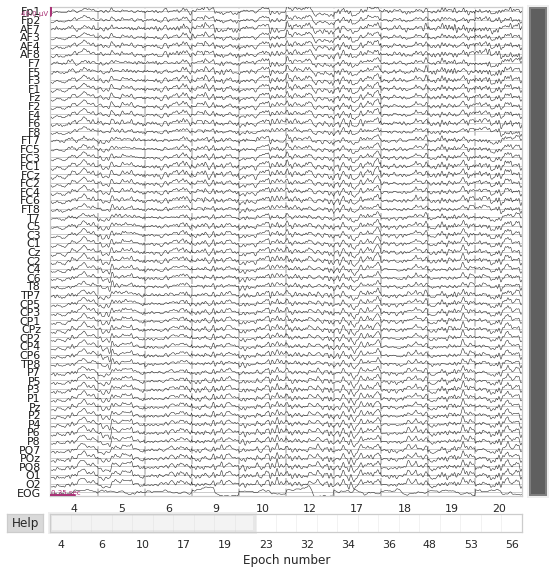

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S06_Sess04.csv
Creating RawArray with float64 data, n_channels=58, n_times=132001
    Range : 0 ... 132000 =      0.000 ...   660.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


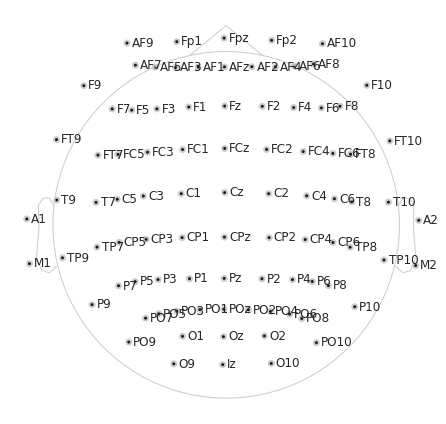

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



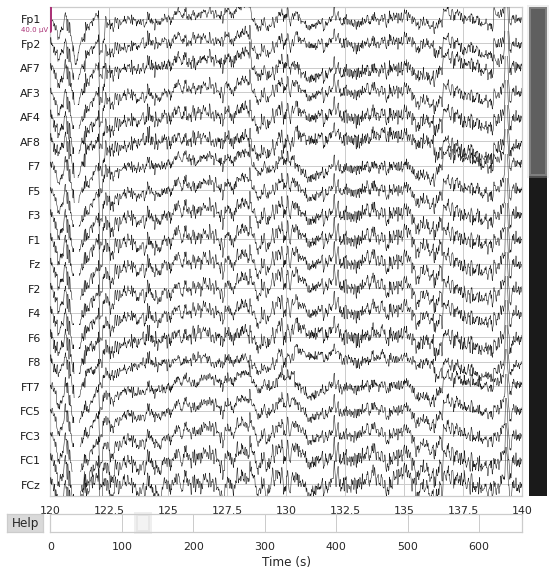

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


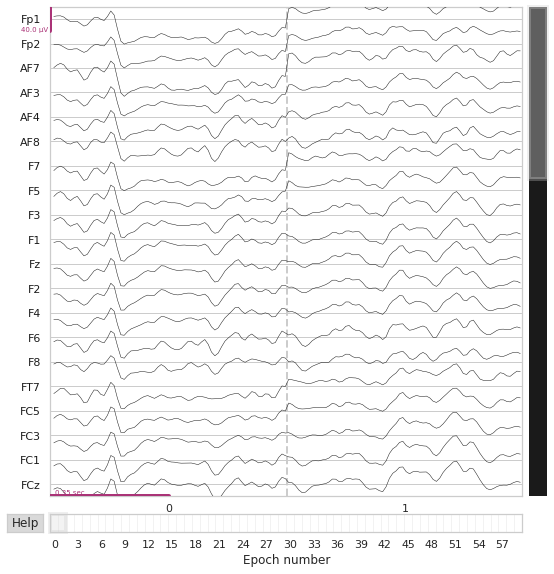

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F5', 'F3', 'F6', 'F8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'C5', 'C3', 'C1', 'Cz', 'C2', 'CP3', 'CP1', 'CPz', 'P3', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F4', 'F6', 'F8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F6', 'F8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4

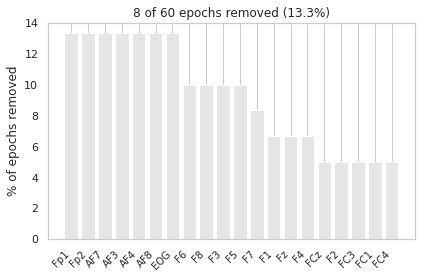

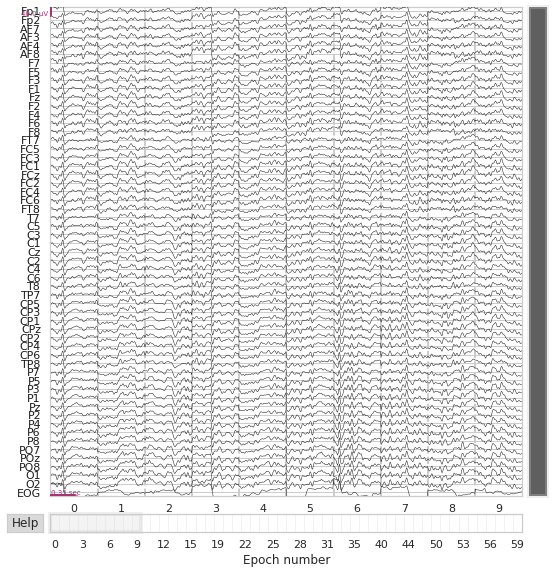

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S06_Sess05.csv
Creating RawArray with float64 data, n_channels=58, n_times=196001
    Range : 0 ... 196000 =      0.000 ...   980.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


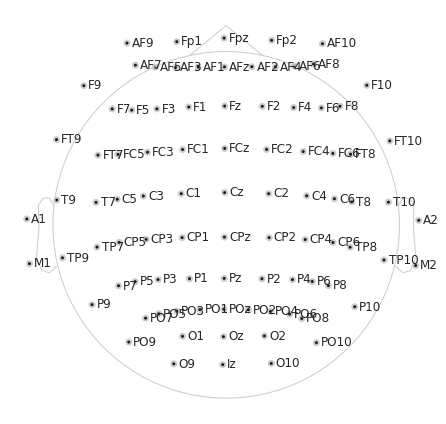

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.8s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



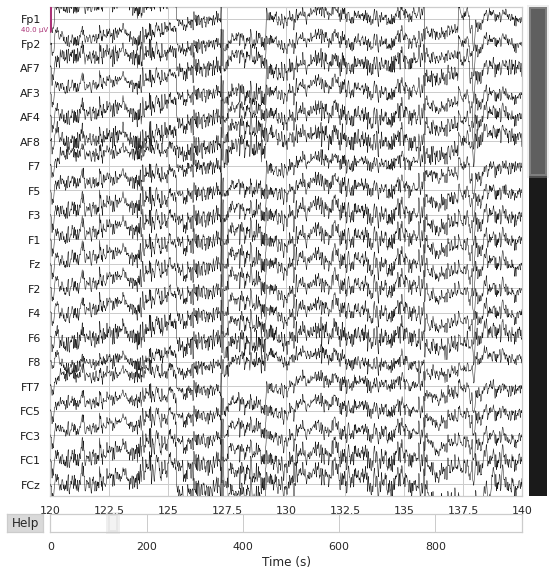

Not setting metadata
100 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 100 events and 141 original time points ...
0 bad epochs dropped


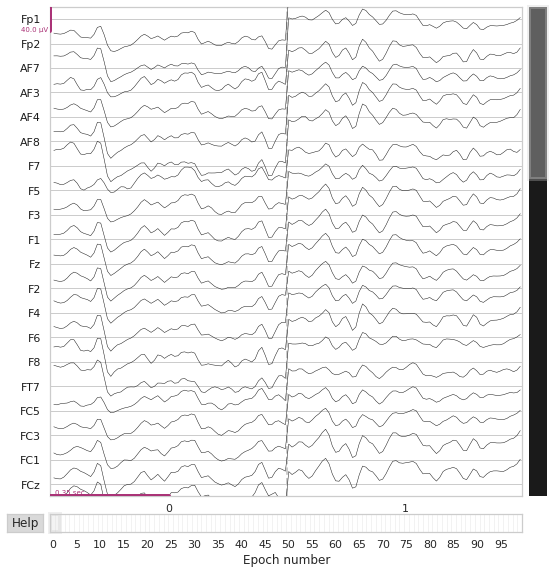

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Cz']
    Rejecting  epoch based on EEG : ['AF7']
    Rejecting  epoch based on EEG : ['AF7']
    Rejecting  epoch based on EEG : ['FCz', 'CP2', 'P2', 'PO8']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'C2', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'C1', 'Cz', 'C2', 'C4', 'CPz', 'CP2', 'CP4', 'P1', 'Pz', 'P2', 'P4', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz

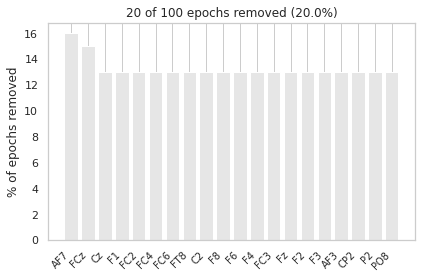

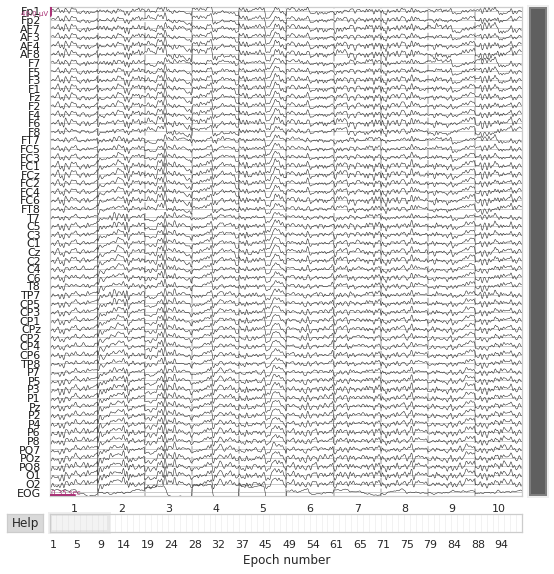

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S07_Sess01.csv
Creating RawArray with float64 data, n_channels=58, n_times=134401
    Range : 0 ... 134400 =      0.000 ...   672.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


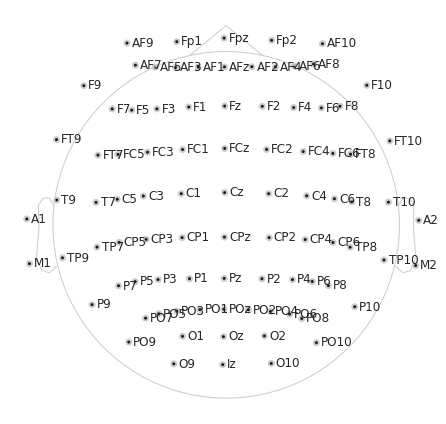

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



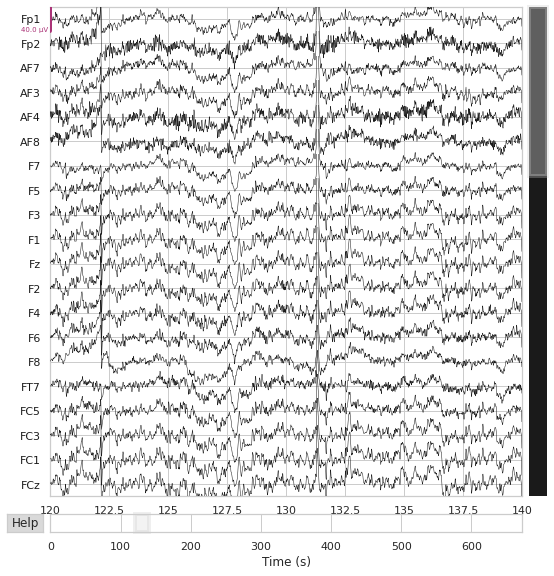

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


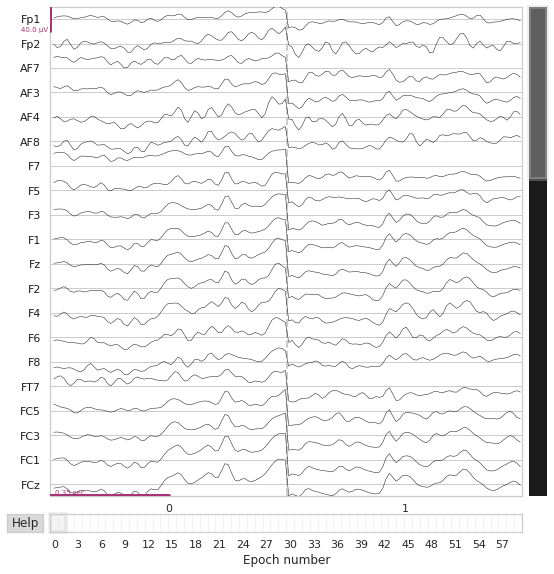

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FC5', 'EOG']
    Rejecting  epoch based on EEG : ['P5', 'P3', 'P1', 'Pz', 'PO7', 'POz', 'O1']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP

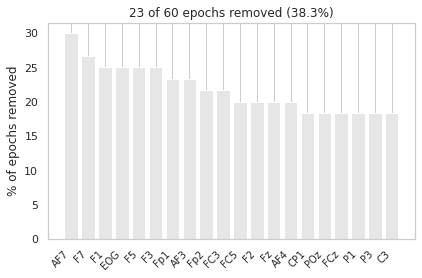

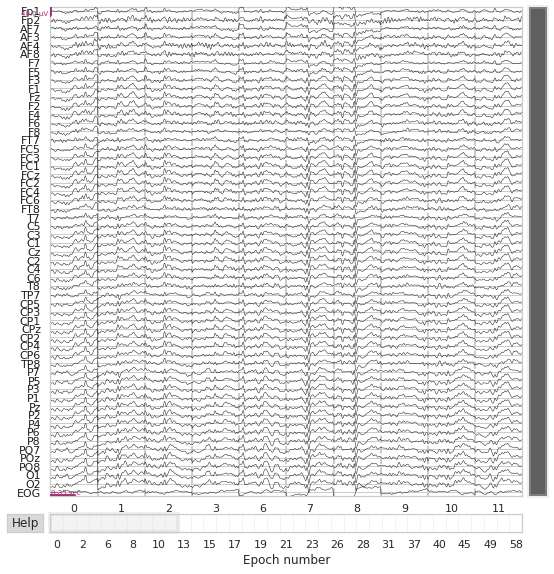

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S07_Sess02.csv
Creating RawArray with float64 data, n_channels=58, n_times=136001
    Range : 0 ... 136000 =      0.000 ...   680.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


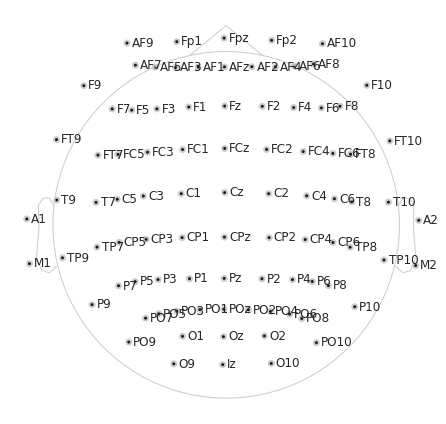

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



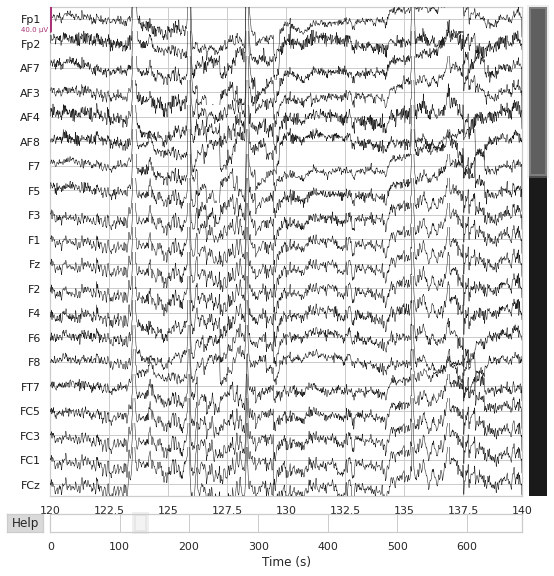

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


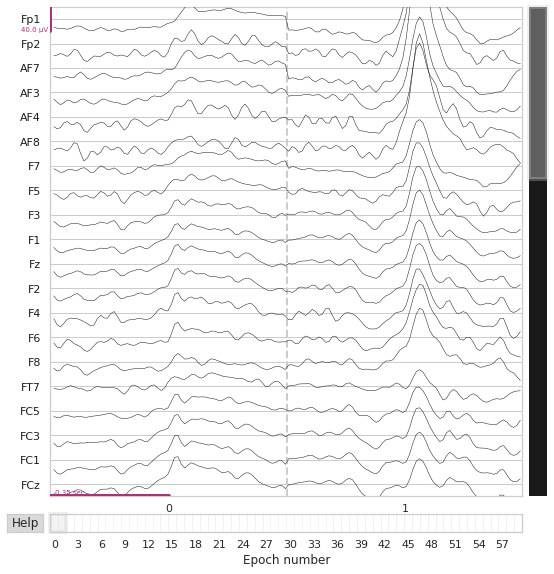

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'POz', 'EOG']
    Rejecting  epoch based on EEG : ['Cz', 'C2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T

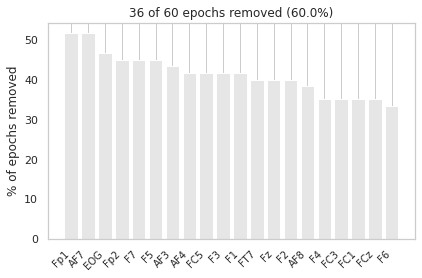

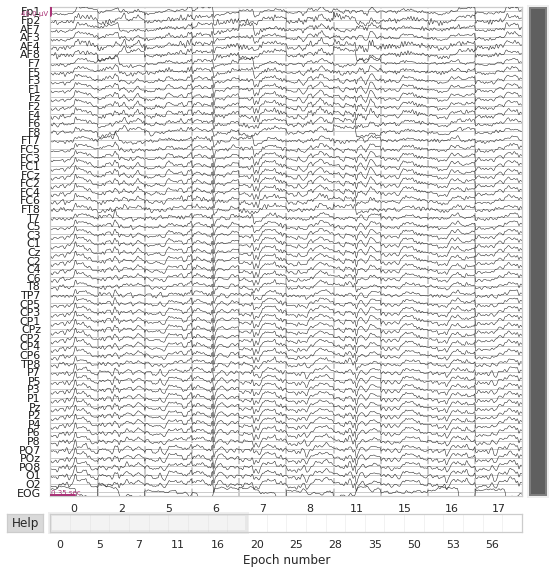

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S07_Sess03.csv
Creating RawArray with float64 data, n_channels=58, n_times=136001
    Range : 0 ... 136000 =      0.000 ...   680.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


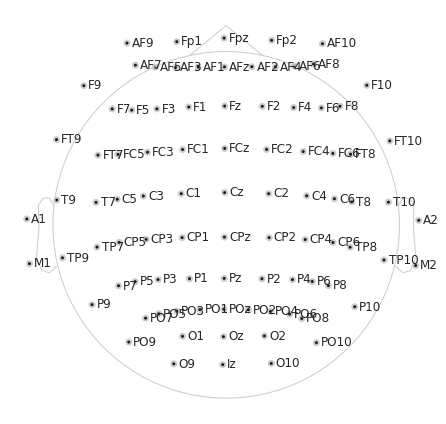

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



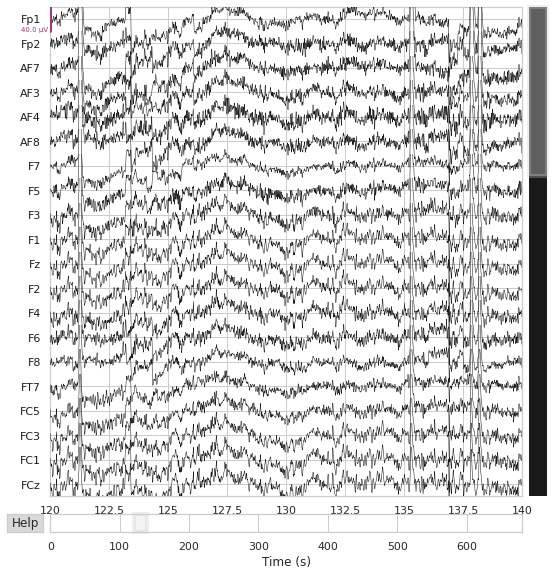

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


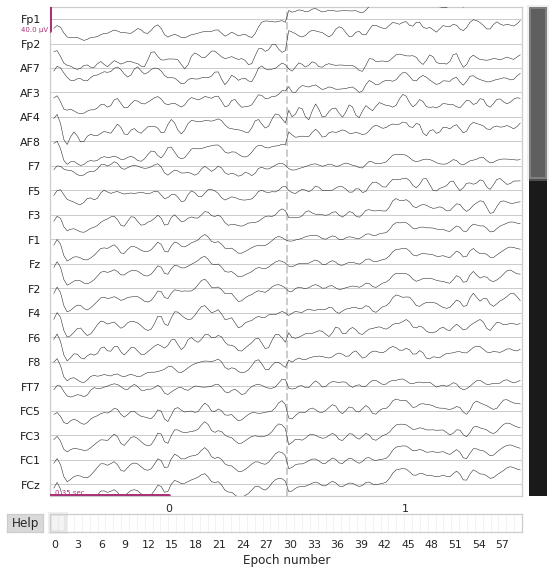

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF4', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'EOG']
    Rejecting  epoch based on EEG : ['AF7', 'F7', 'F5', 'FT7', 'FC5', 'T7', 'C5', 'TP7', 'EOG']
10 bad epochs dropped


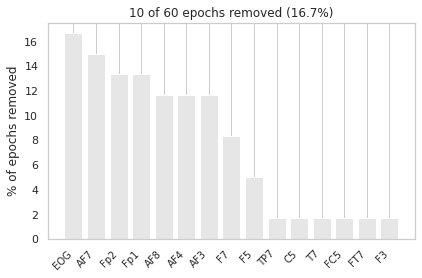

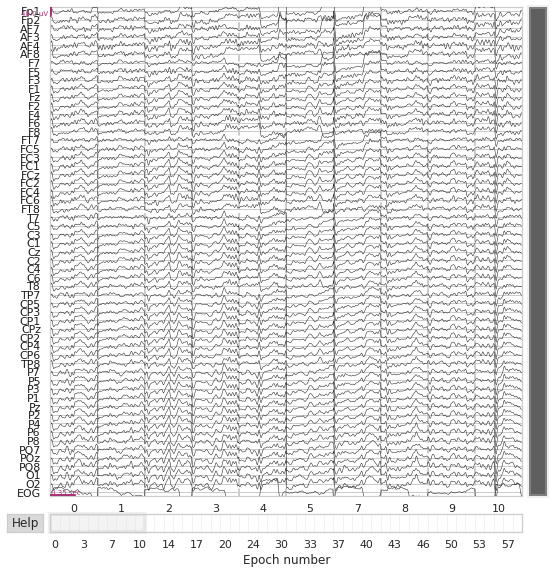

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S07_Sess04.csv
Creating RawArray with float64 data, n_channels=58, n_times=135001
    Range : 0 ... 135000 =      0.000 ...   675.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


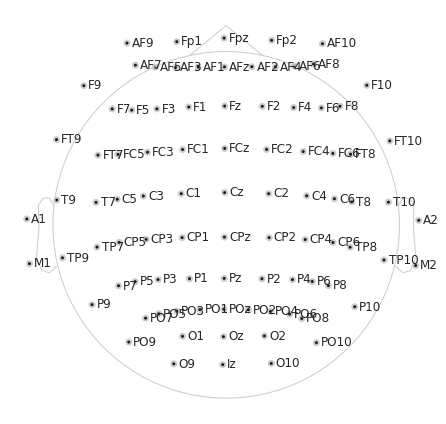

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



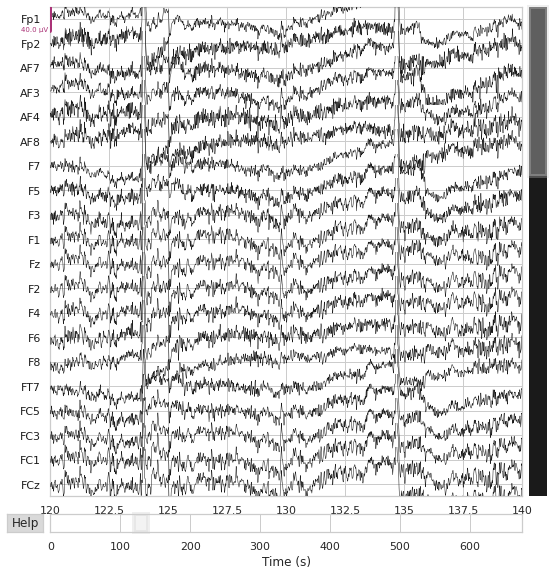

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


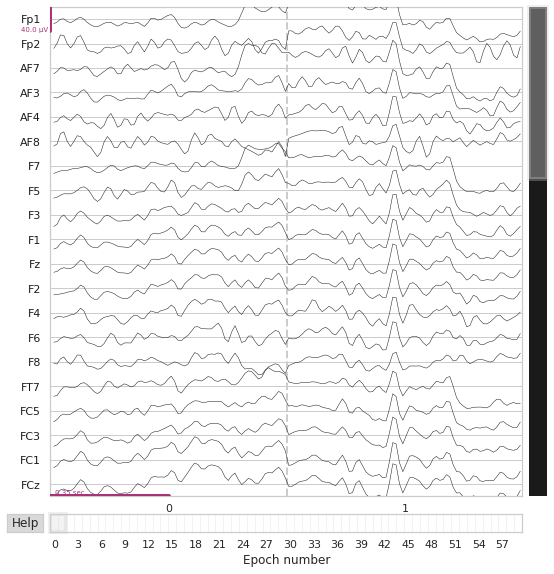

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
14 bad epochs dropped


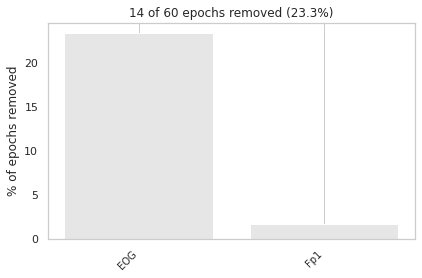

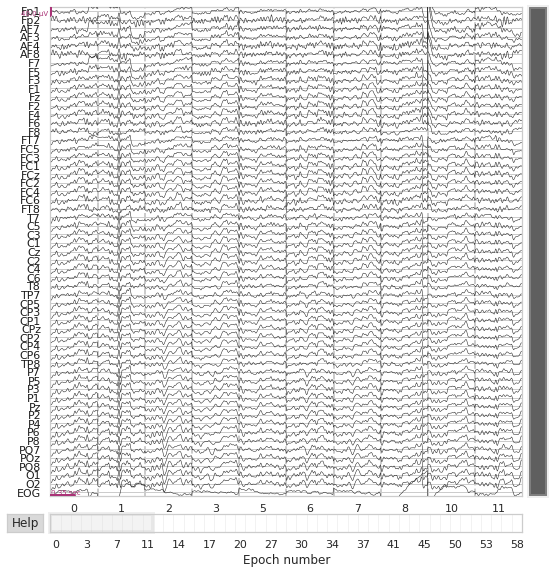

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S07_Sess05.csv
Creating RawArray with float64 data, n_channels=58, n_times=203001
    Range : 0 ... 203000 =      0.000 ...  1015.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


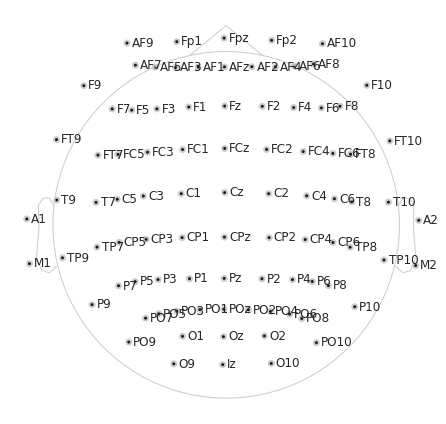

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    1.0s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



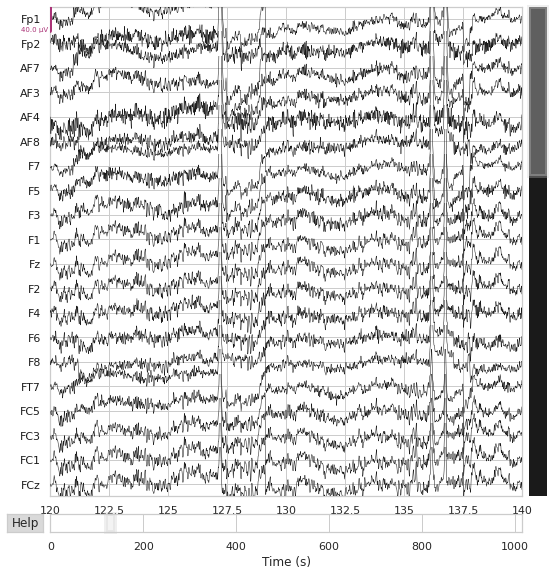

Not setting metadata
100 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 100 events and 141 original time points ...
0 bad epochs dropped


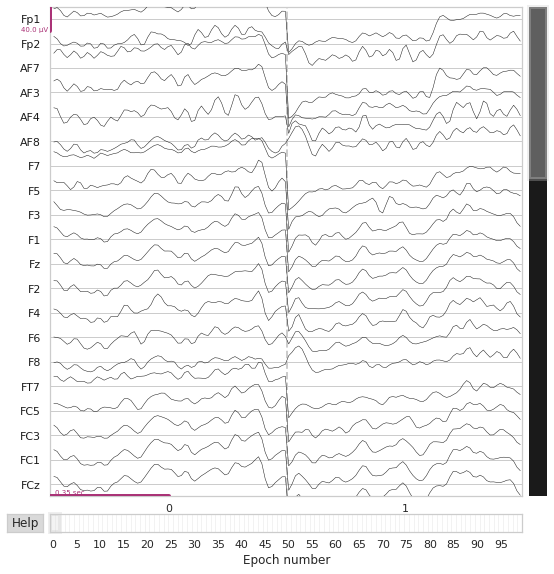

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'AF7', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based o

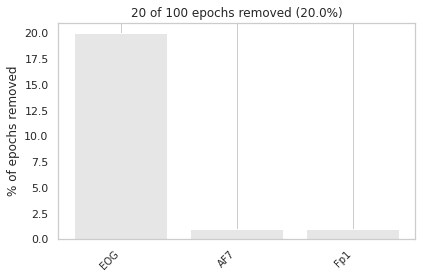

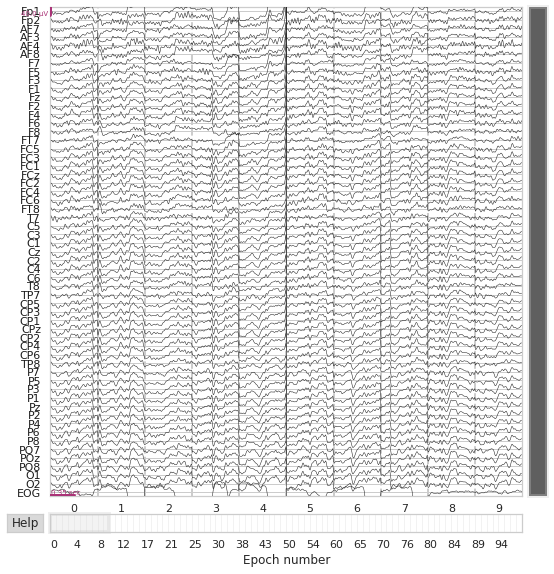

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S11_Sess01.csv
Creating RawArray with float64 data, n_channels=58, n_times=145001
    Range : 0 ... 145000 =      0.000 ...   725.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


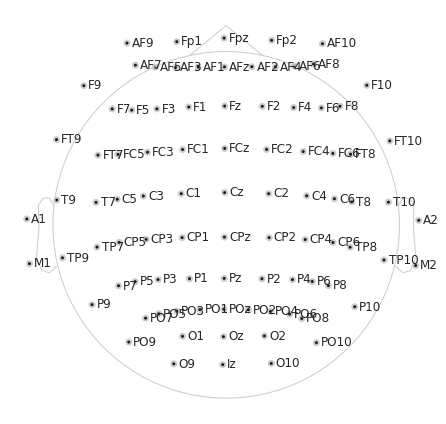

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



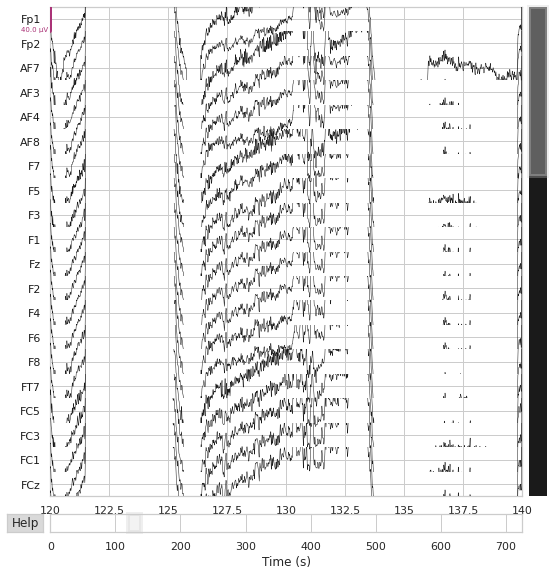

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


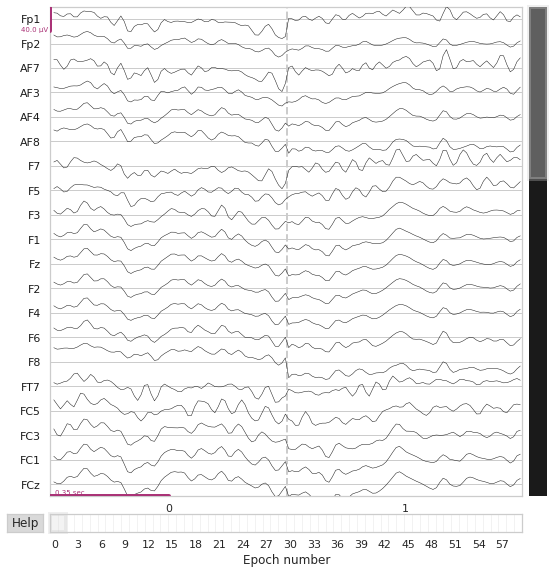

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F6', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF8', 'EOG']
    Rejecting  epoch based on EEG : ['

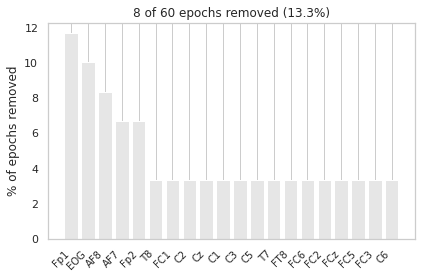

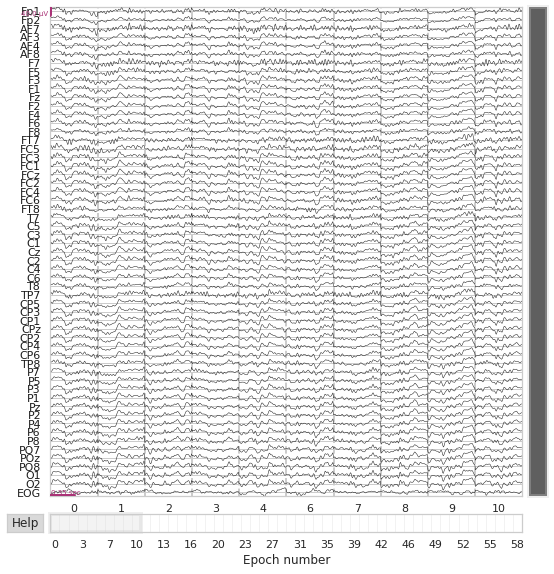

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S11_Sess02.csv
Creating RawArray with float64 data, n_channels=58, n_times=155001
    Range : 0 ... 155000 =      0.000 ...   775.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


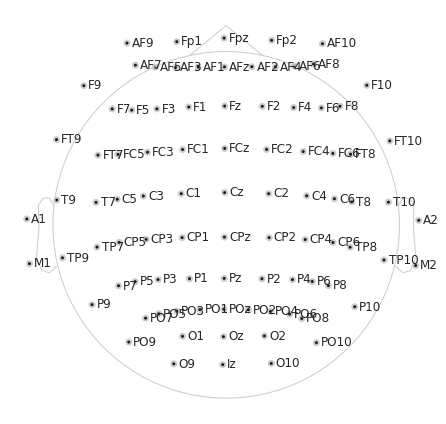

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



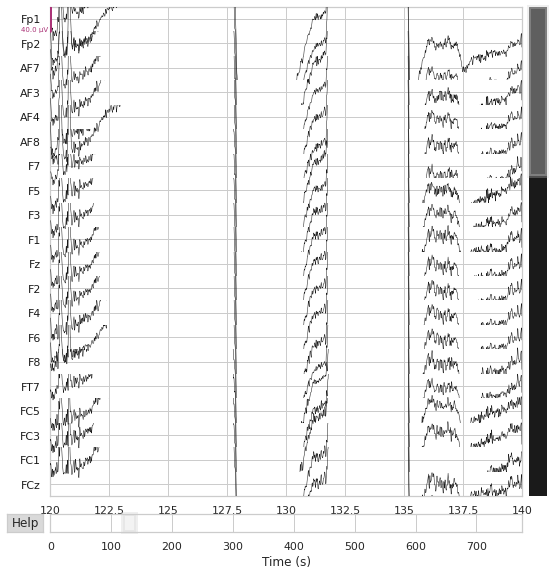

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


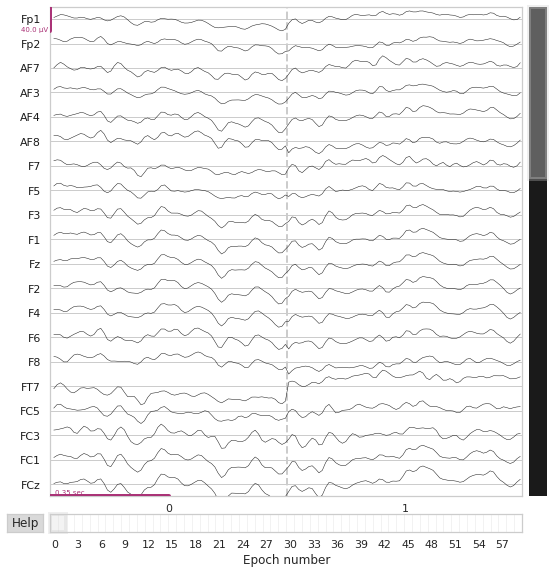

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp2', 'AF7', 'AF4', 'AF8', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP6', 'TP8', 'P3', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', '

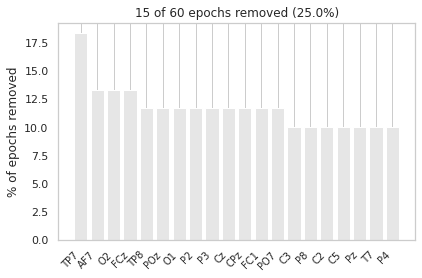

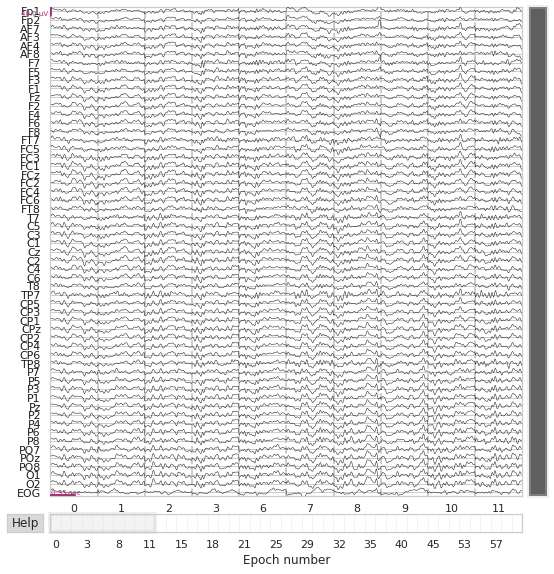

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S11_Sess03.csv
Creating RawArray with float64 data, n_channels=58, n_times=146801
    Range : 0 ... 146800 =      0.000 ...   734.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


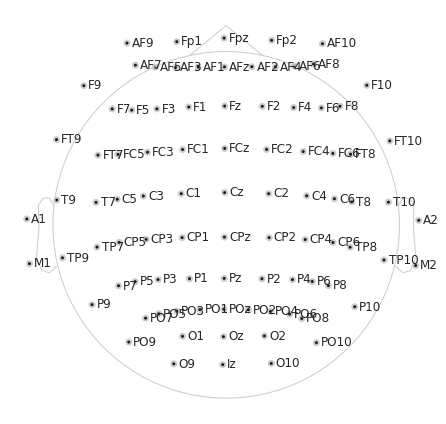

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.5s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



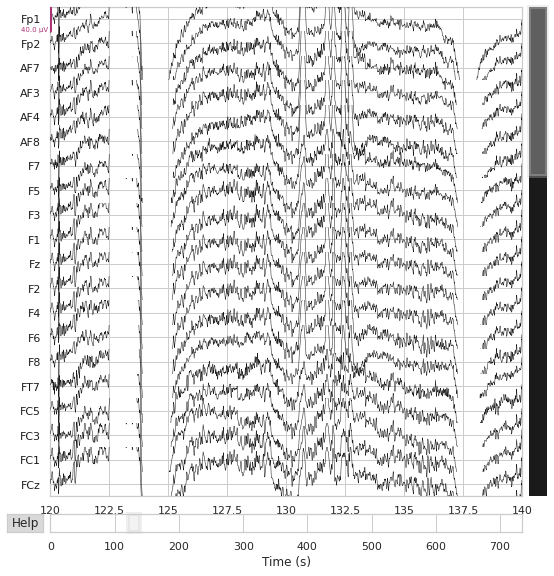

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


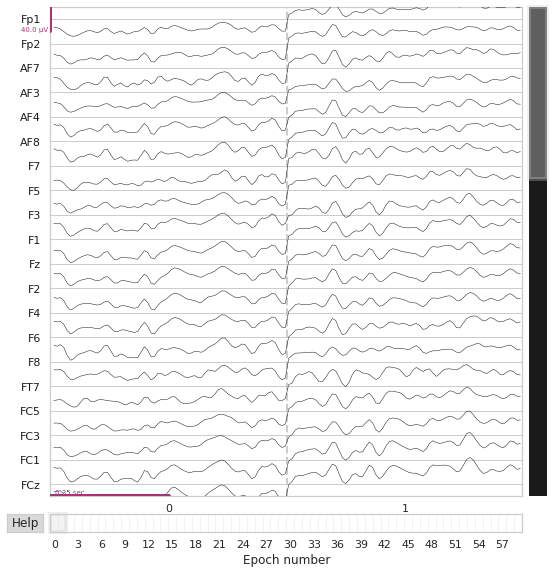

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['P2', 'P4', 'P6', 'P8', 'PO8', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    

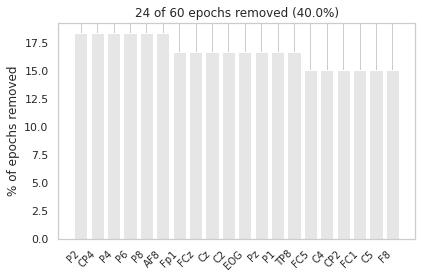

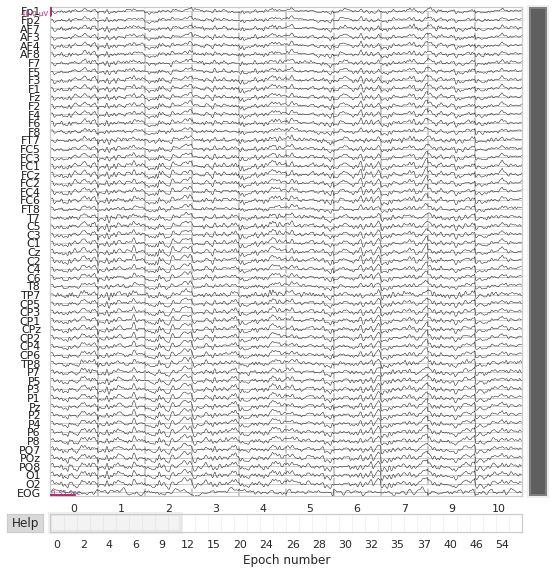

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S11_Sess04.csv
Creating RawArray with float64 data, n_channels=58, n_times=149001
    Range : 0 ... 149000 =      0.000 ...   745.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


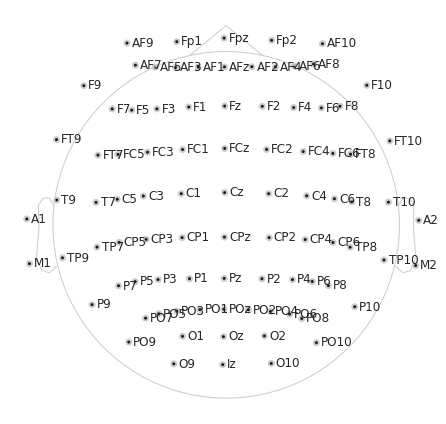

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



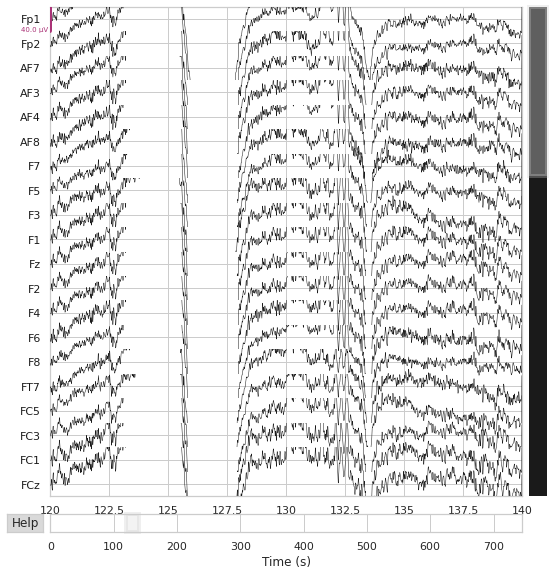

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


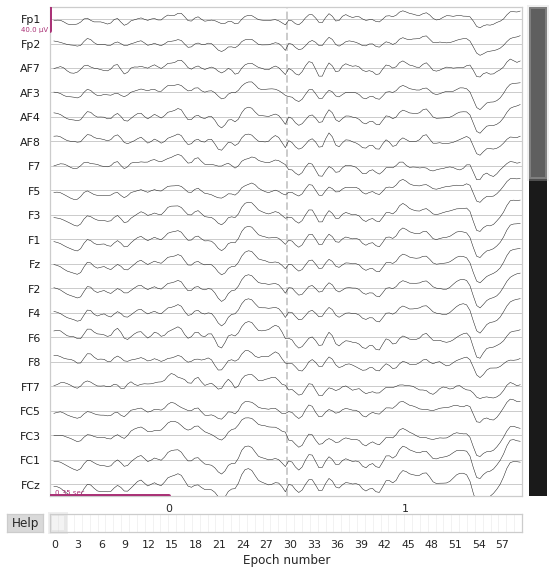

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'EOG']
    Rejecting  epoch based on EEG : ['Pz', 'P2', 'P4', 'POz', 'EOG']
    Rejecting  epoch based on EEG : ['AF7', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['F3', 'F1', 'Fz', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Re

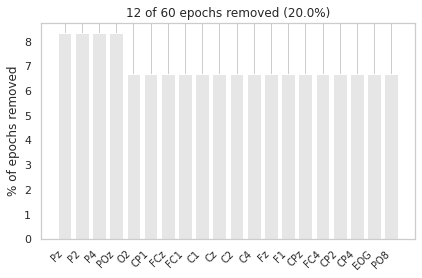

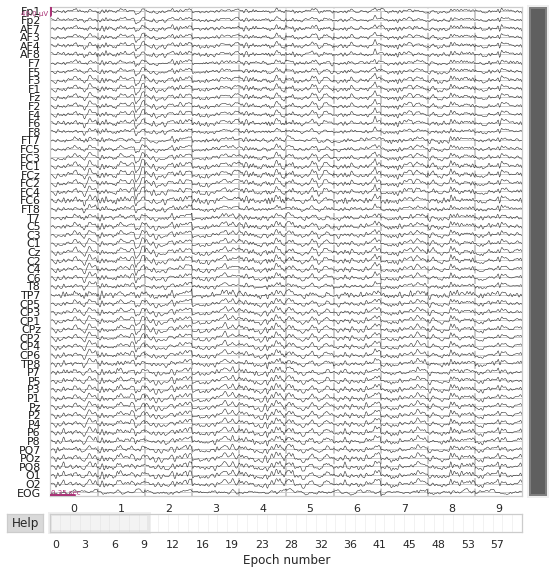

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S11_Sess05.csv
Creating RawArray with float64 data, n_channels=58, n_times=239001
    Range : 0 ... 239000 =      0.000 ...  1195.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


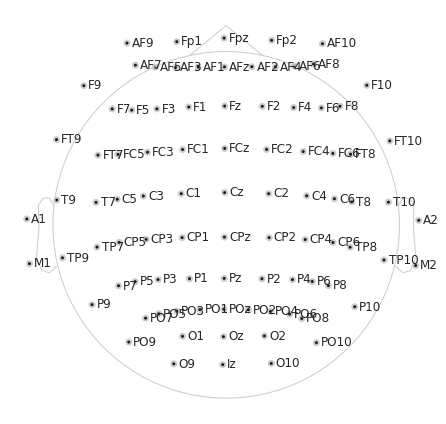

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    1.0s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



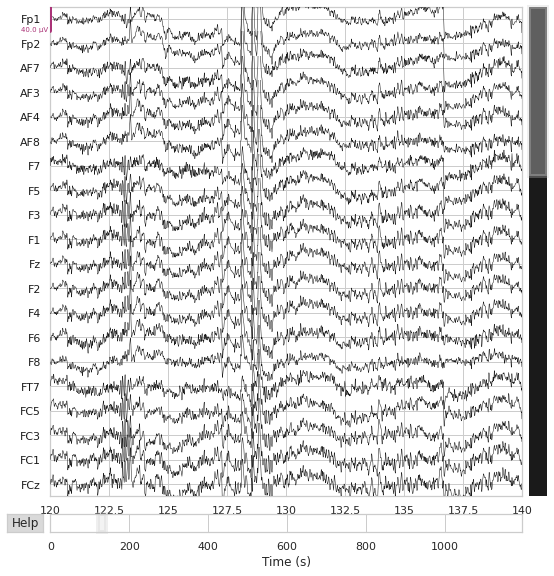

Not setting metadata
100 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 100 events and 141 original time points ...
0 bad epochs dropped


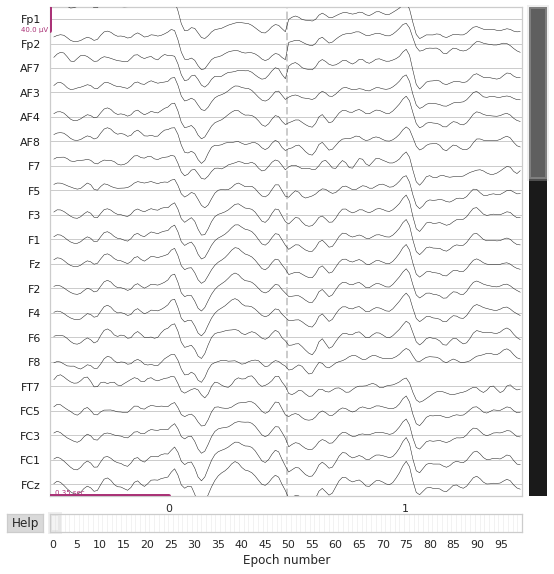

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'AF7']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2']
    Rejecting  epoch based on EEG : ['AF7']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 

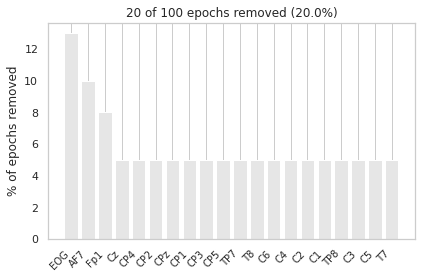

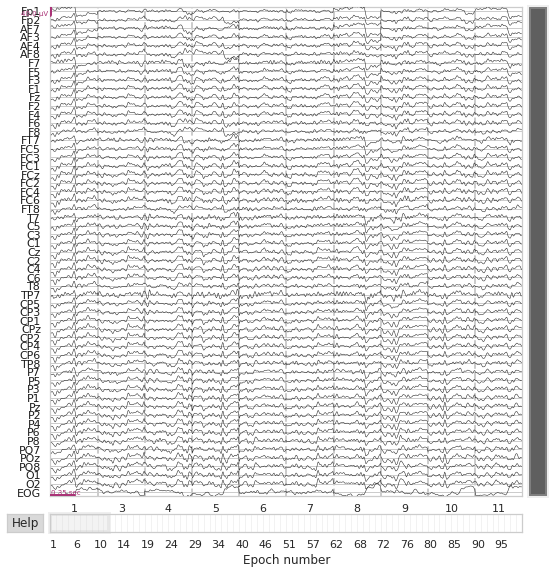

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S12_Sess01.csv
Creating RawArray with float64 data, n_channels=58, n_times=166001
    Range : 0 ... 166000 =      0.000 ...   830.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


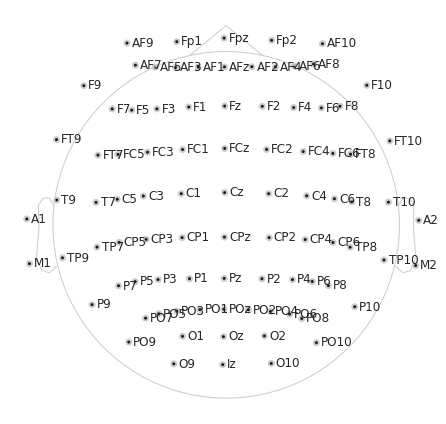

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.7s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



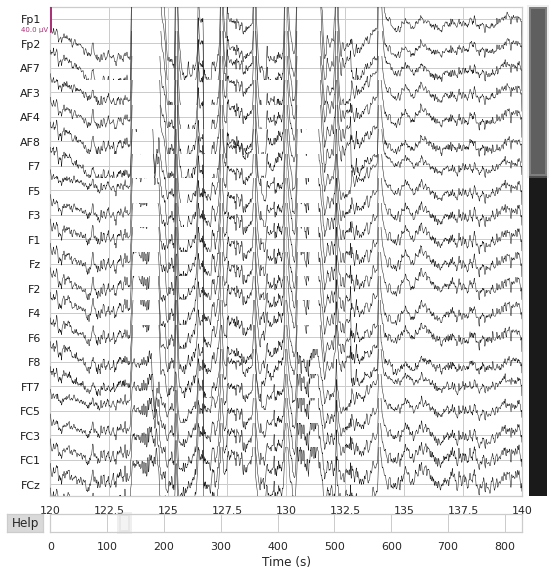

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


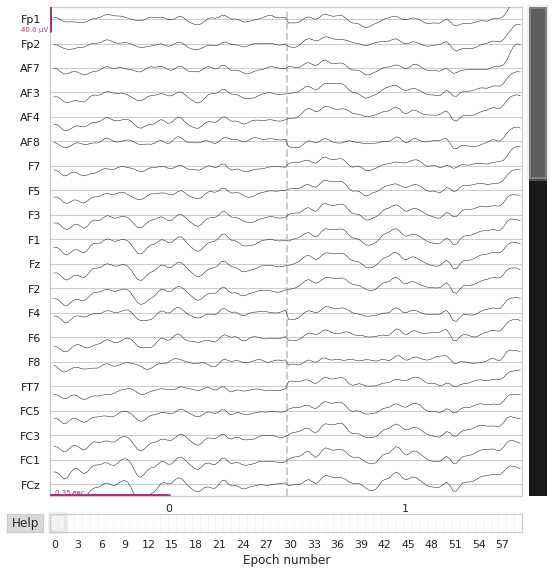

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
18 bad epochs dropped


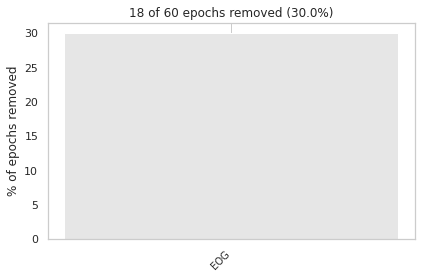

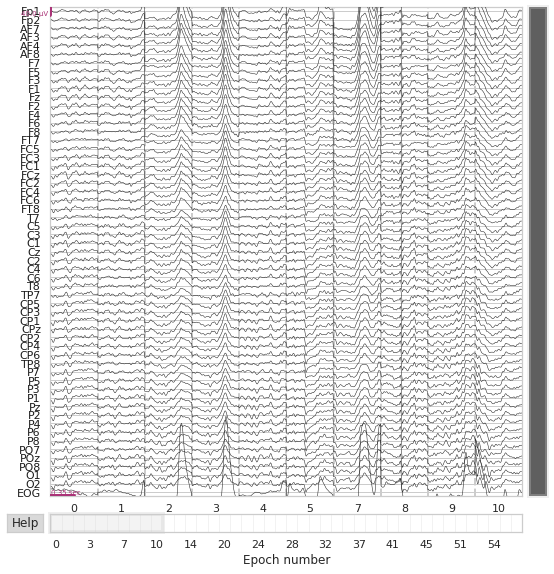

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S12_Sess02.csv
Creating RawArray with float64 data, n_channels=58, n_times=147001
    Range : 0 ... 147000 =      0.000 ...   735.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


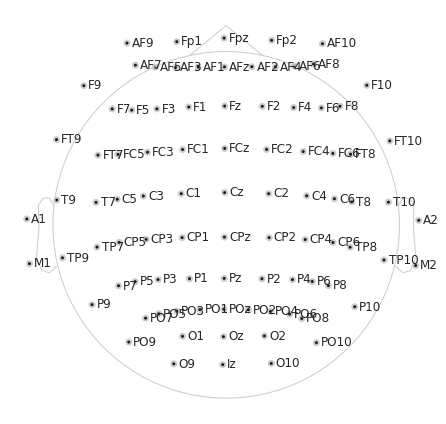

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



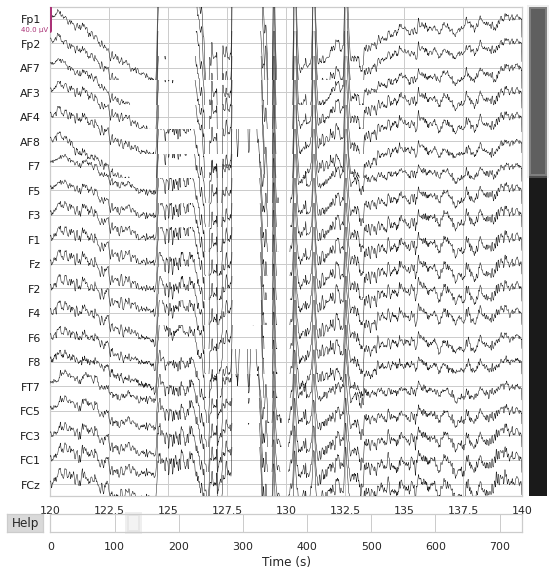

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


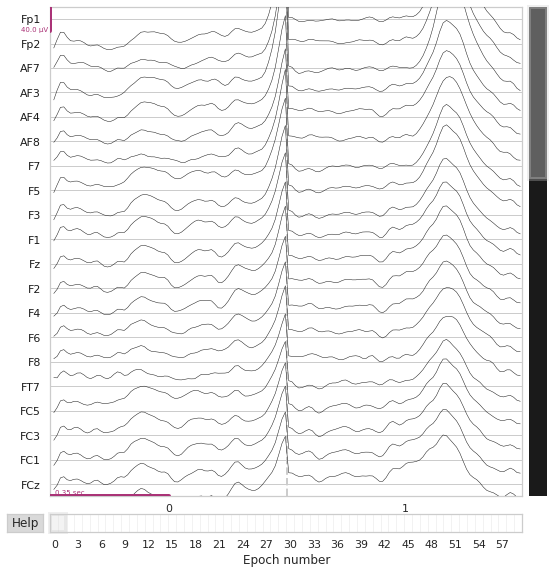

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG'

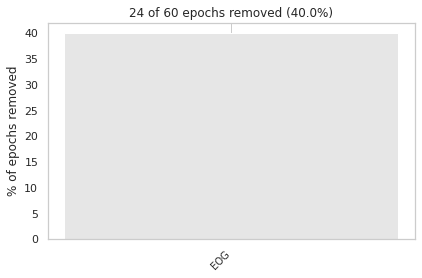

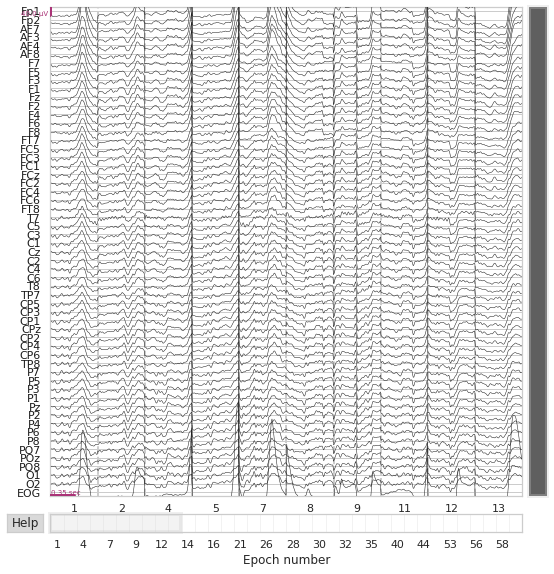

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S12_Sess03.csv
Creating RawArray with float64 data, n_channels=58, n_times=150001
    Range : 0 ... 150000 =      0.000 ...   750.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


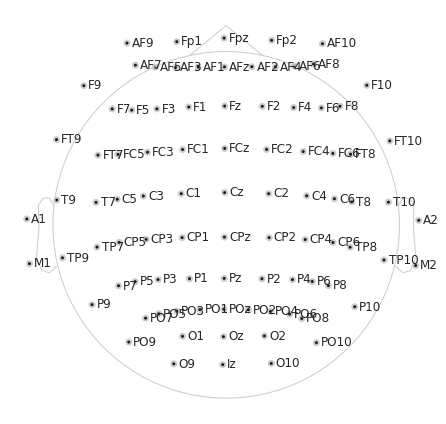

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.7s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



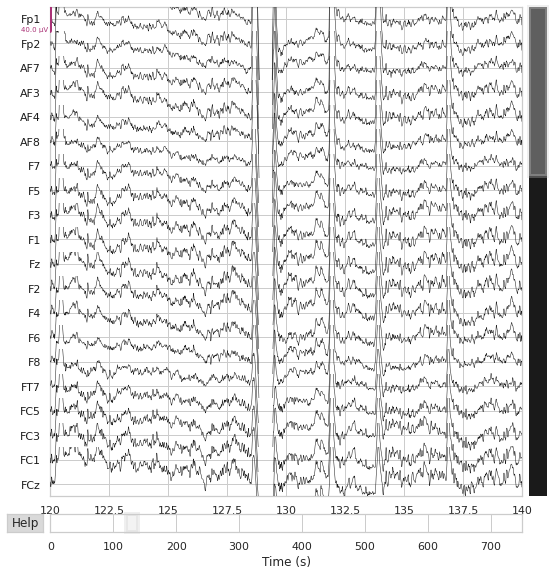

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


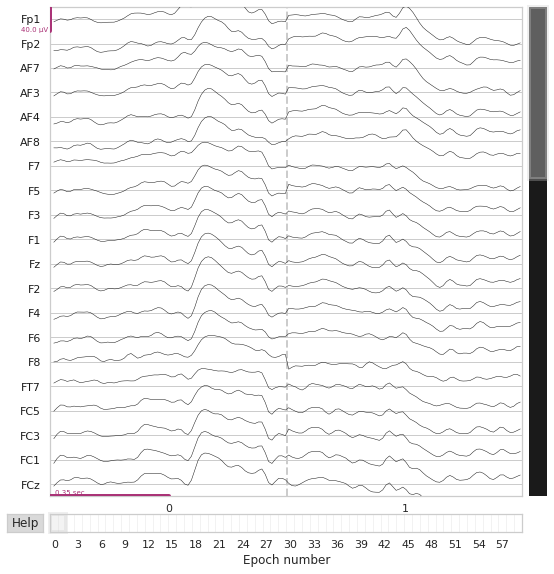

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
12 bad epochs dropped


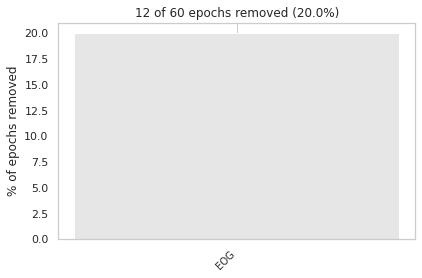

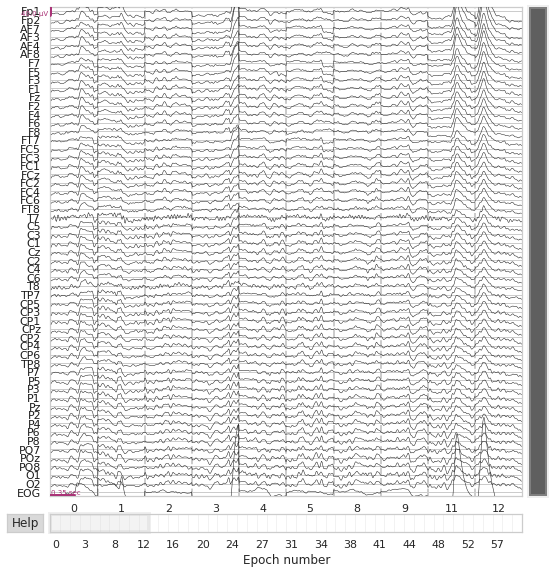

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S12_Sess04.csv
Creating RawArray with float64 data, n_channels=58, n_times=148601
    Range : 0 ... 148600 =      0.000 ...   743.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


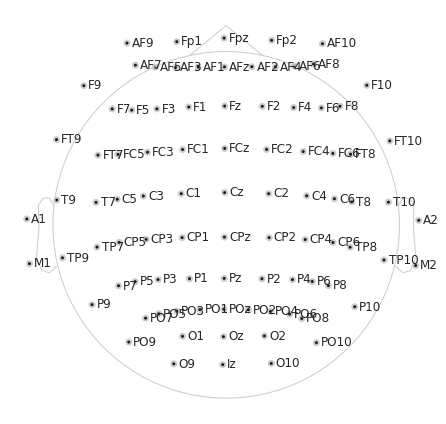

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



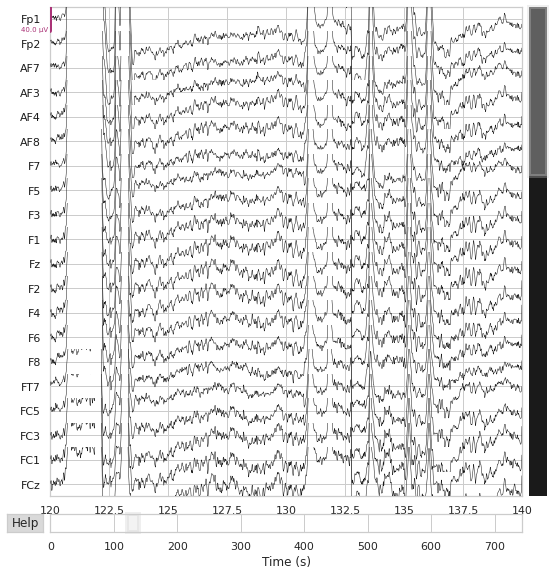

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


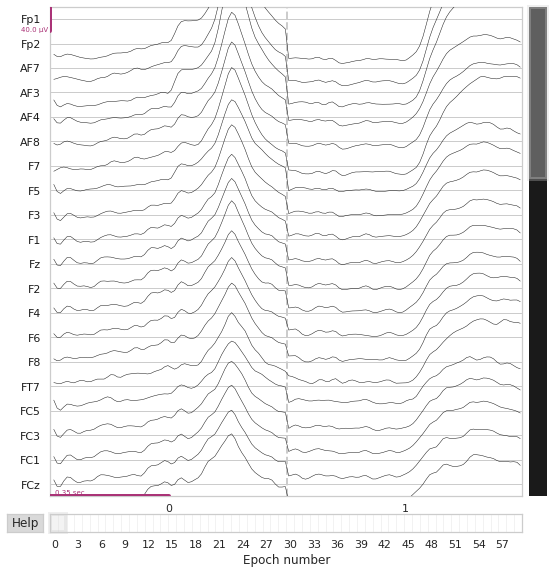

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG'

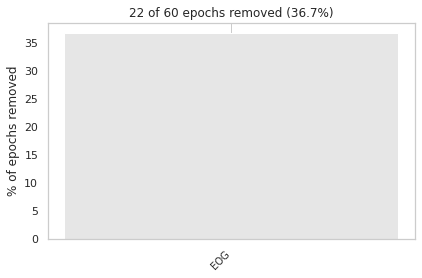

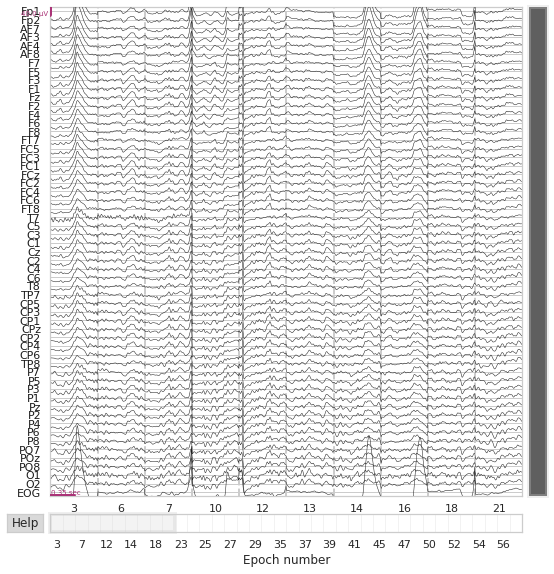

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S12_Sess05.csv
Creating RawArray with float64 data, n_channels=58, n_times=236601
    Range : 0 ... 236600 =      0.000 ...  1183.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


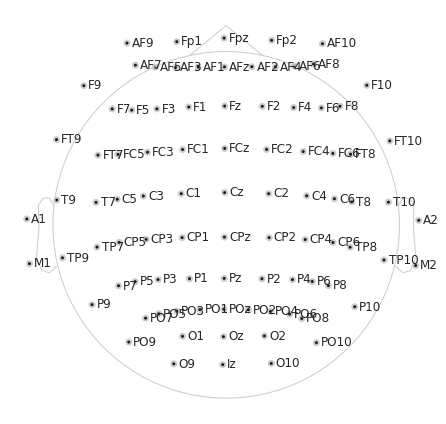

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.9s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



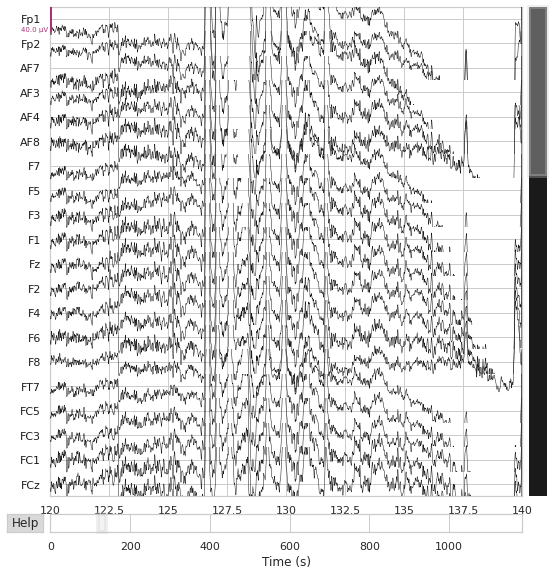

Not setting metadata
100 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 100 events and 141 original time points ...
0 bad epochs dropped


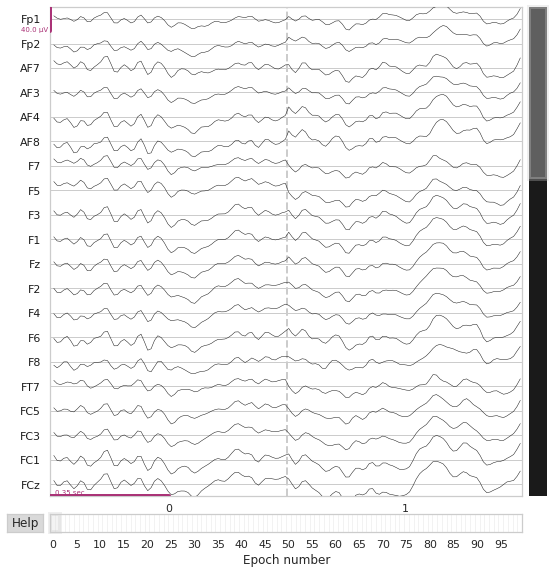

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch 

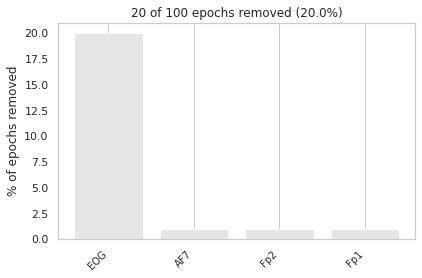

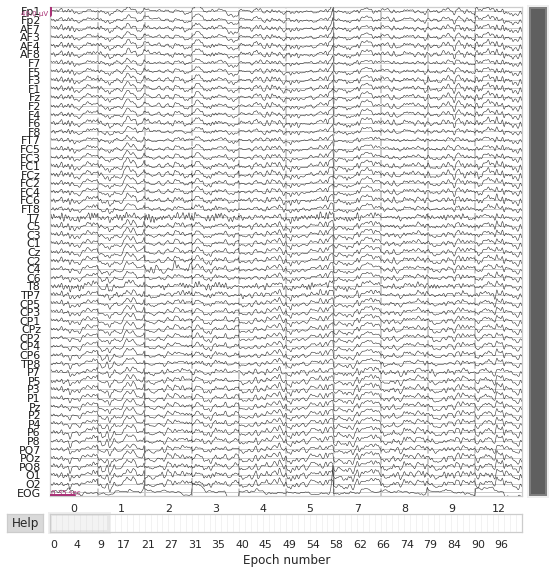

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S13_Sess01.csv
Creating RawArray with float64 data, n_channels=58, n_times=154001
    Range : 0 ... 154000 =      0.000 ...   770.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


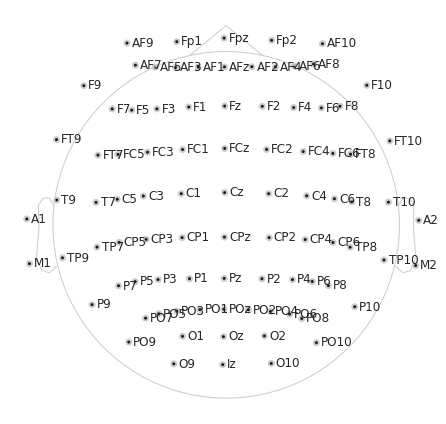

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



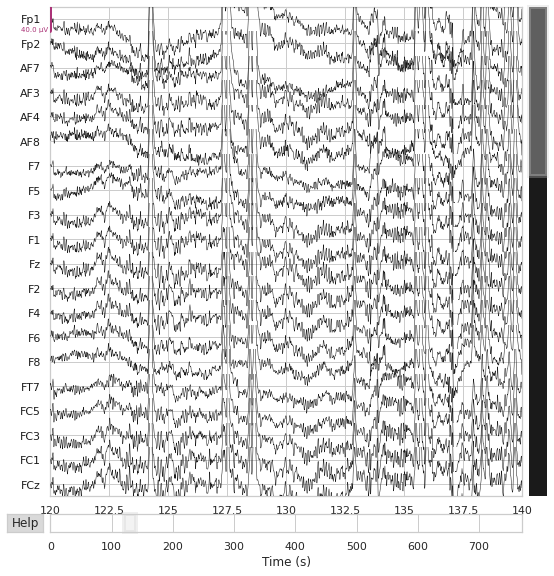

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


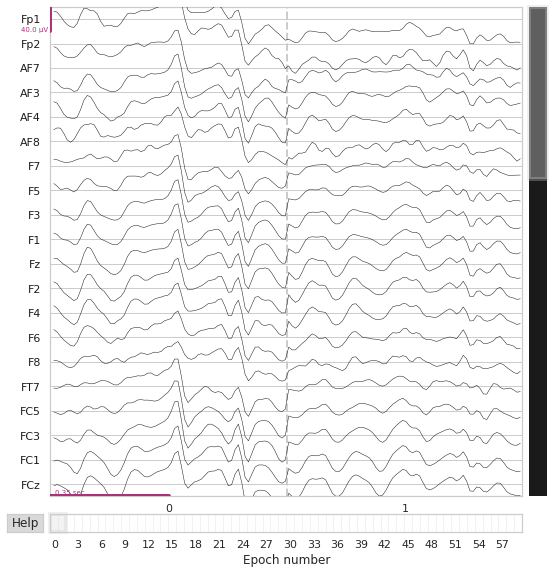

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2', 'EOG']
    Rejecting  epoch based on EEG : ['CP3', 'P5', 'P3', 'P1', 'PO7', 'POz']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'POz', 'PO8', 'O1', 'O2', 'EOG']
 

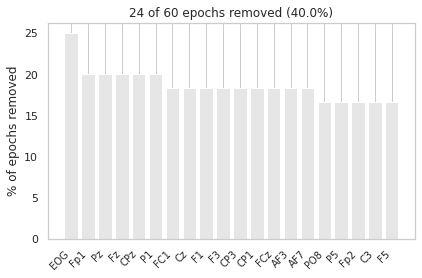

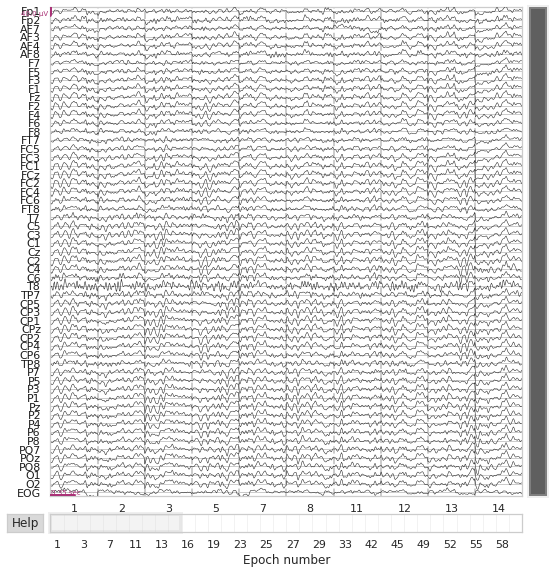

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S13_Sess02.csv
Creating RawArray with float64 data, n_channels=58, n_times=150201
    Range : 0 ... 150200 =      0.000 ...   751.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


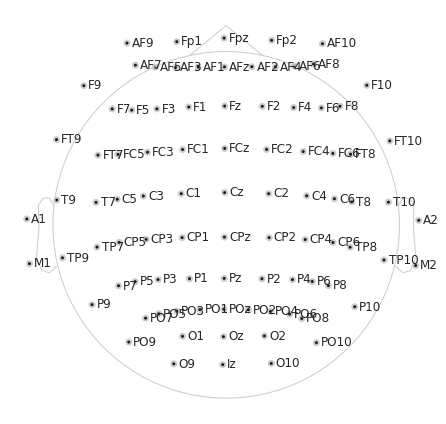

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.9s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



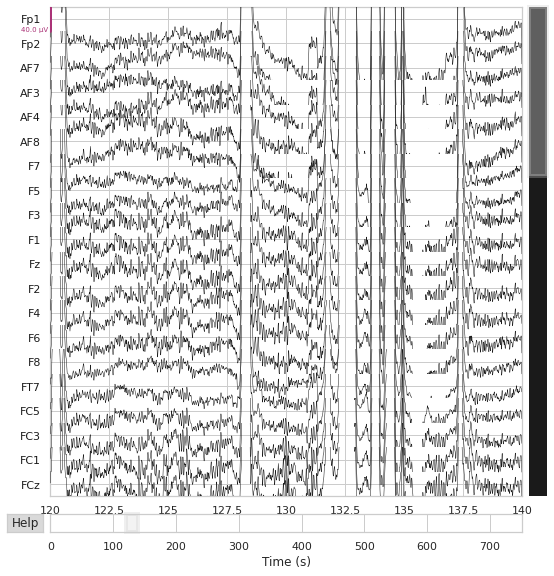

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


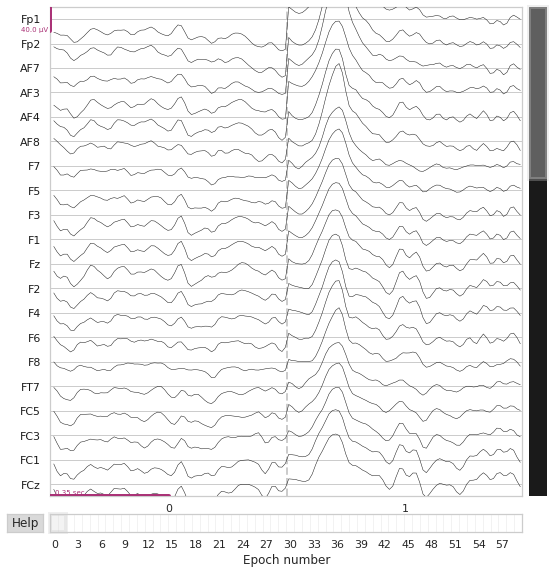

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
0 bad epochs dropped


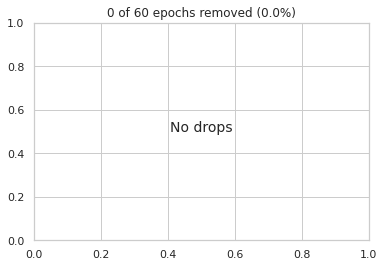

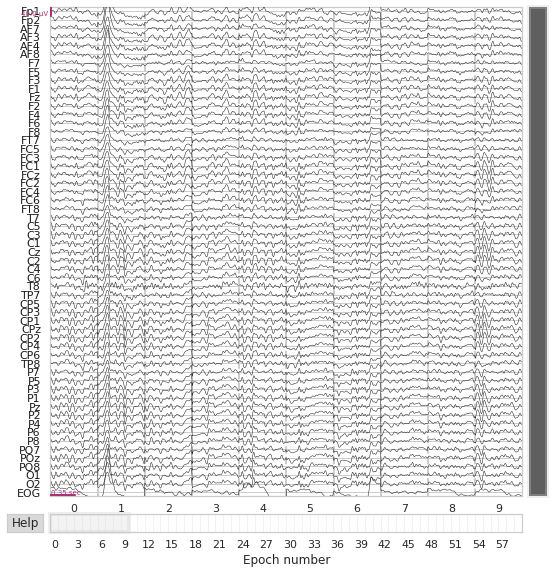

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S13_Sess03.csv
Creating RawArray with float64 data, n_channels=58, n_times=151601
    Range : 0 ... 151600 =      0.000 ...   758.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


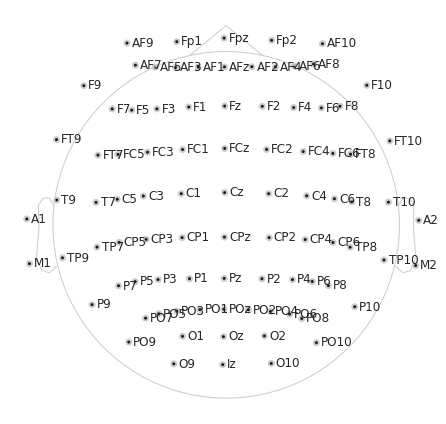

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.7s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



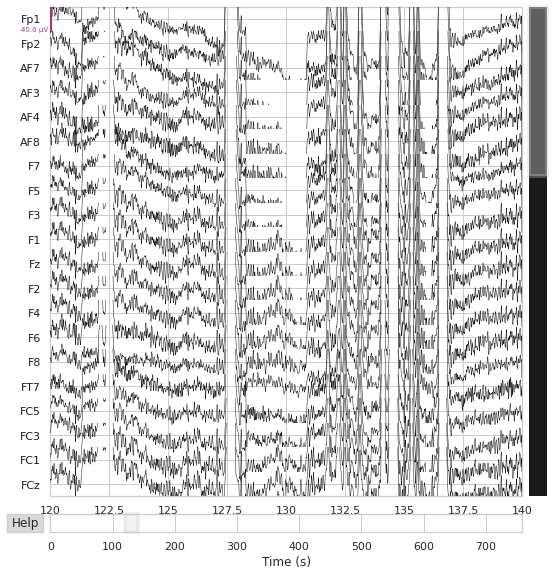

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


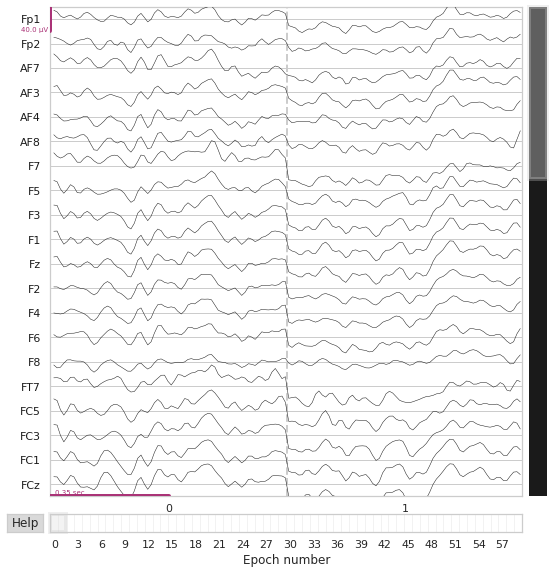

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
0 bad epochs dropped


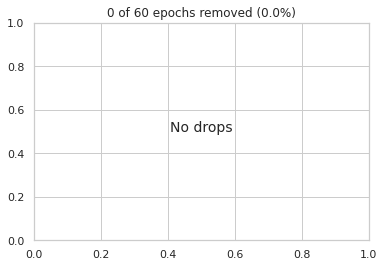

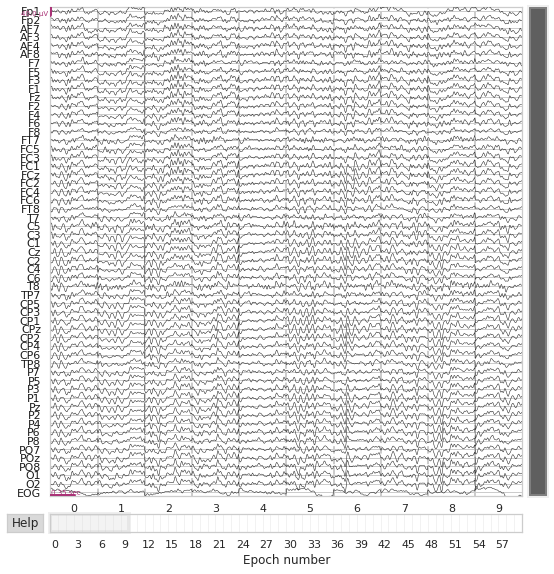

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S13_Sess04.csv
Creating RawArray with float64 data, n_channels=58, n_times=152001
    Range : 0 ... 152000 =      0.000 ...   760.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


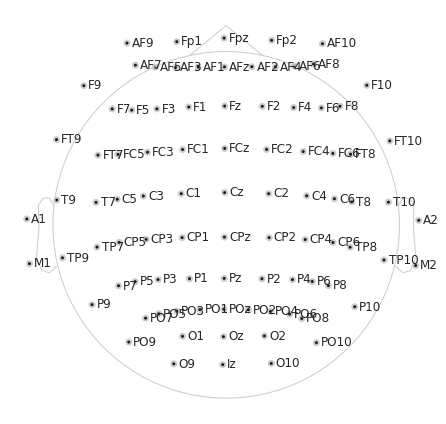

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



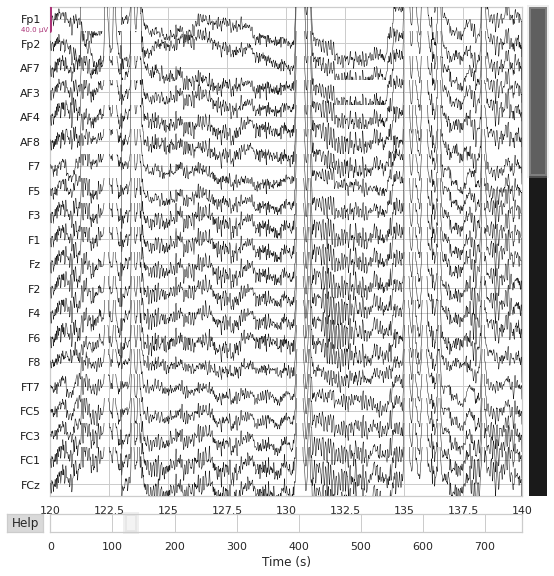

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


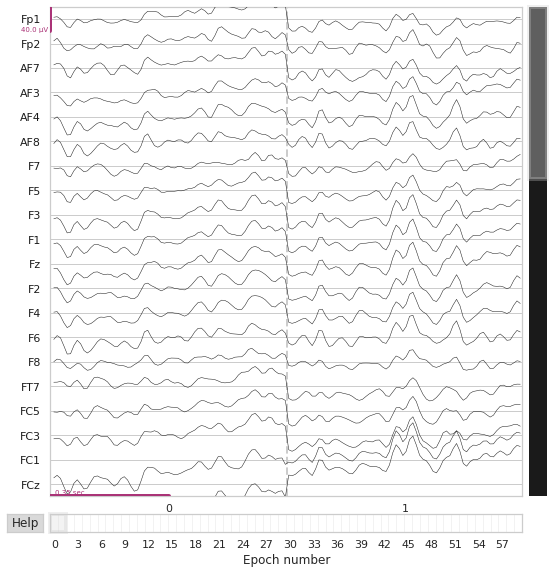

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['FCz']
    Rejecting  epoch based on EEG : ['C2', 'CP2']
    Rejecting  epoch based on EEG : ['C5', 'C3', 'C1']
    Rejecting  epoch based on EEG : ['Fp1', 'FC1', 'FCz', 'C1', 'Cz', 'C2', 'CP3', 'CP1', 'CPz', 'CP2', 'P3', 'P1', 'Pz', 'EOG']
    Rejecting  epoch based on EEG : ['FC1', 'FCz', 'FC2', 'C1', 'Cz', 'C2', 'CP1', 'CPz', 'CP2', 'P2', 'P4', 'P6']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'FT7', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'T7', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'TP7', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'PO7', 'POz', 'PO8', 'O1', 'O2', 'EOG']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF3', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'F

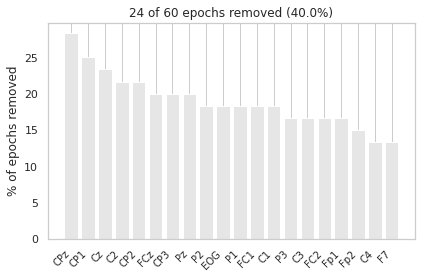

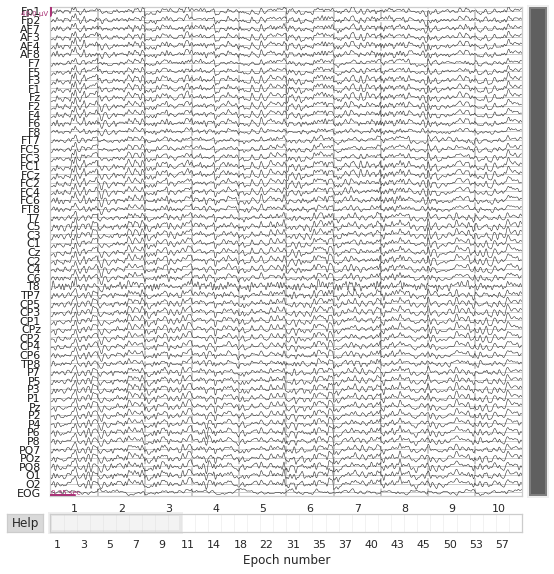

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S13_Sess05.csv
Creating RawArray with float64 data, n_channels=58, n_times=242801
    Range : 0 ... 242800 =      0.000 ...  1214.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


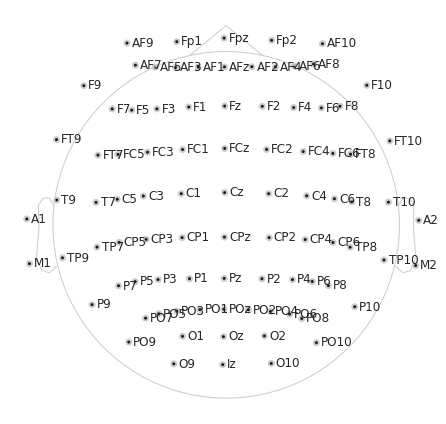

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    1.2s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



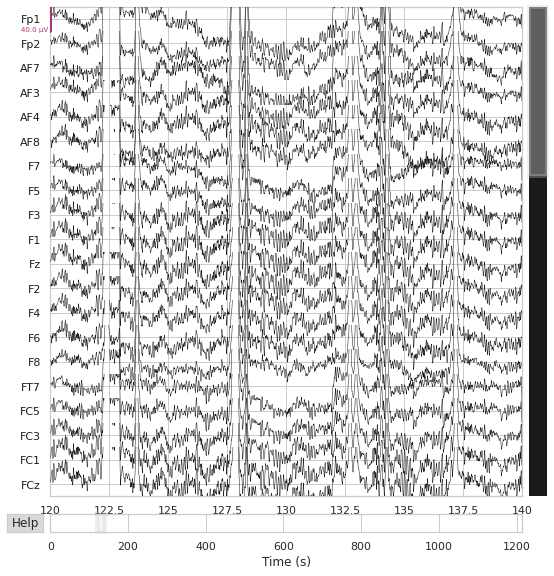

Not setting metadata
100 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 100 events and 141 original time points ...
0 bad epochs dropped


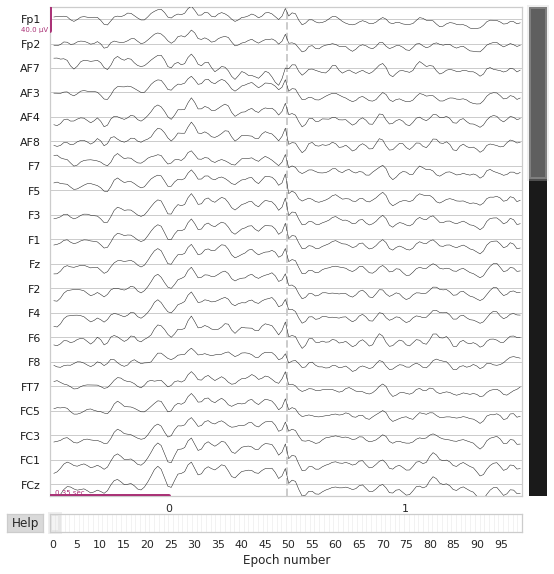

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['Cz', 'CPz', 'P1', 'Pz']
    Rejecting  epoch based on EEG : ['EOG']
    Rejecting  epoch based on EEG : ['P4', 'P6', 'PO8']
    Rejecting  epoch based on EEG : ['Pz']
    Rejecting  epoch based on EEG : ['Fp1', 'AF7', 'F5', 'F3', 'F1', 'Fz', 'FC1', 'FCz', 'TP7', 'CP5', 'P7']
    Rejecting  epoch based on EEG : ['F3', 'F1', 'Fz', 'F2', 'F4', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'C3', 'C1', 'Cz', 'C2', 'CP3', 'CP1', 'CPz', 'CP2', 'P3', 'P1', 'Pz', 'POz']
    Rejecting  epoch based on EEG : ['CP3', 'CP1', 'P1', 'Pz']
    Rejecting  epoch based on EEG : ['Pz', 'POz']
    Rejecting  epoch based on EEG : ['CP3', 'P3']
    Rejecting  epoch based on EEG : ['Pz', 'P2', 'POz', 'EOG']
    Rejecting  epoch based on EEG : ['C1', 'Cz']
    Rejecting  epoch based on EEG : ['FCz', 'Cz']
    Rejecting  epoch based on EEG : ['P4', 'P6', 'POz', 'PO8

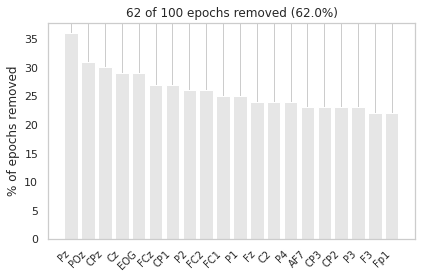

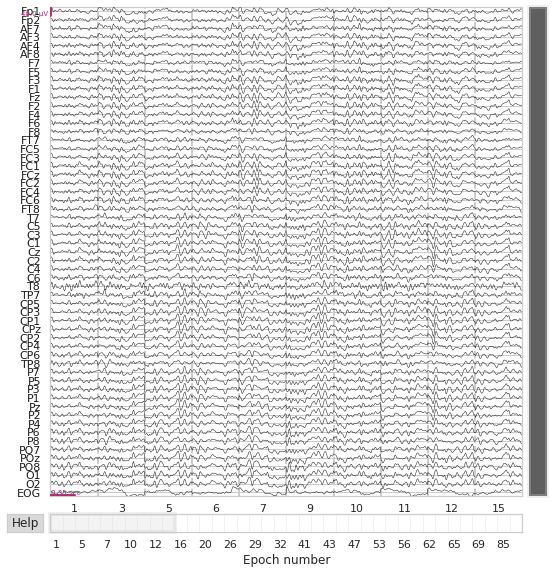

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S14_Sess01.csv
Creating RawArray with float64 data, n_channels=58, n_times=151001
    Range : 0 ... 151000 =      0.000 ...   755.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


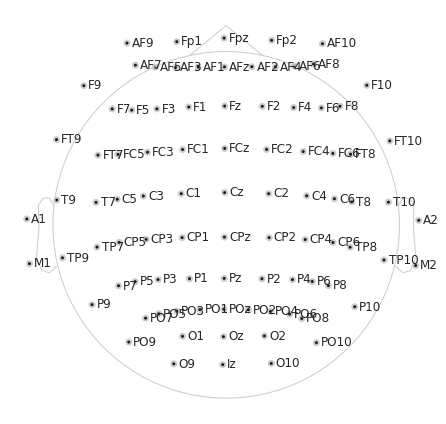

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.6s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



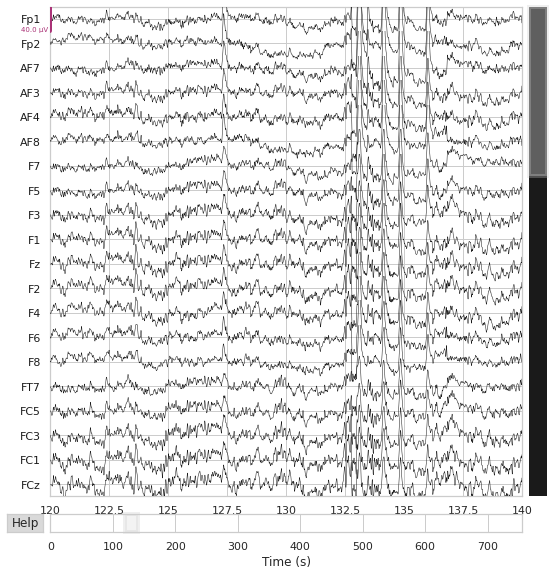

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


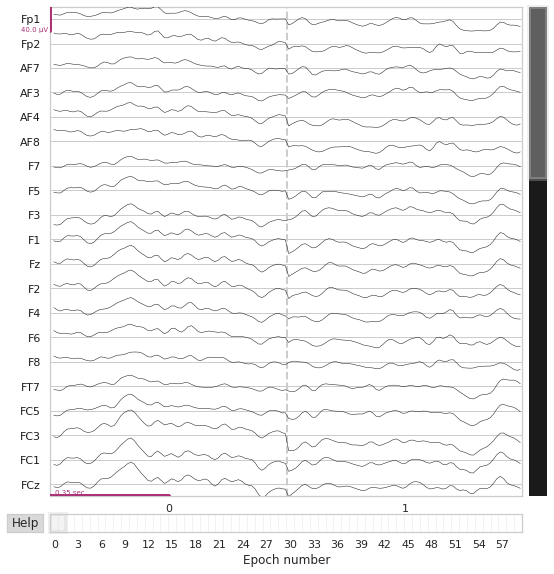

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
0 bad epochs dropped


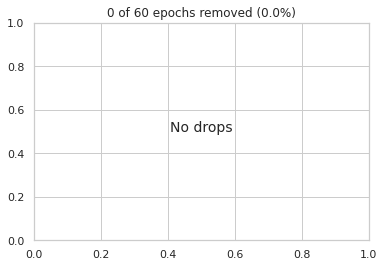

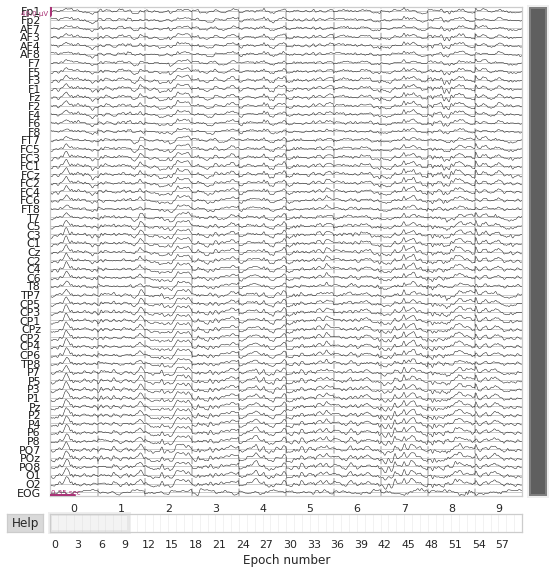

Overwriting existing file.
gdrive/MyDrive/ML/train/Data_S14_Sess02.csv
Creating RawArray with float64 data, n_channels=58, n_times=152601
    Range : 0 ... 152600 =      0.000 ...   763.000 secs
Ready.
4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.


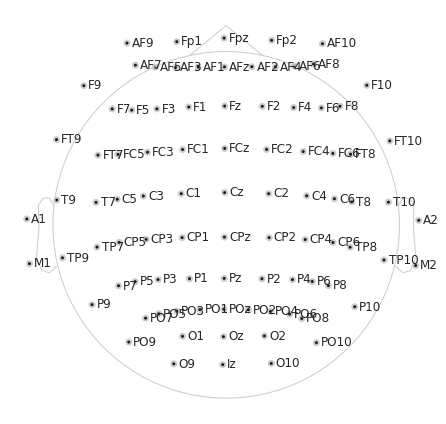

Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1321 samples (6.605 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



[Parallel(n_jobs=1)]: Done  57 out of  57 | elapsed:    0.7s finished


Setting up band-pass filter from 0.05 - 25 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.05, 25.00 Hz: -6.02, -6.02 dB



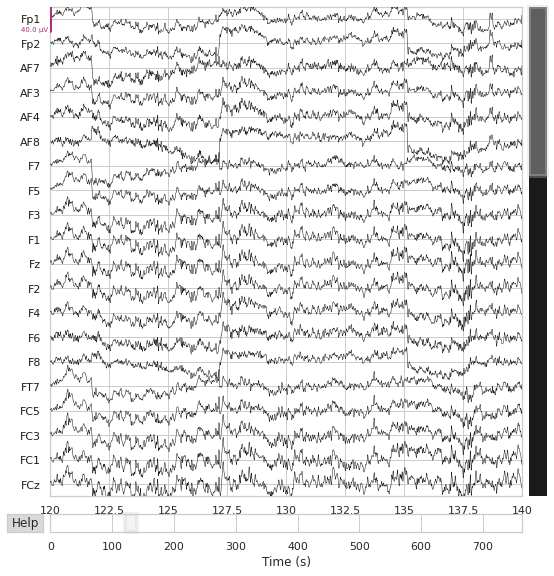

Not setting metadata
60 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 60 events and 141 original time points ...
0 bad epochs dropped


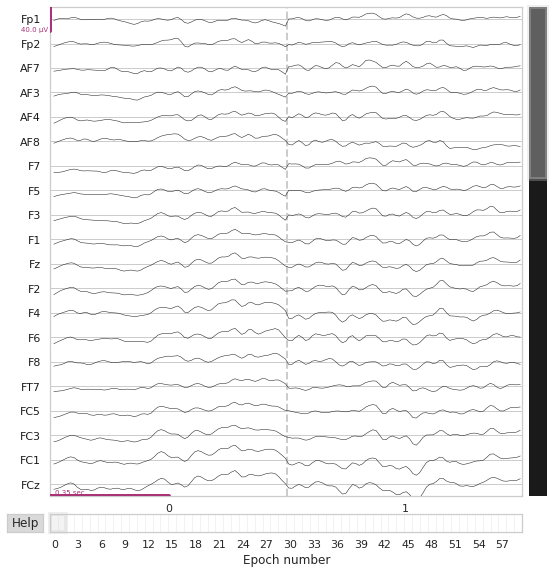

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
Estimating rejection dictionary for eog
    Rejecting  epoch based on EEG : ['CP3']
    Rejecting  epoch based on EEG : ['POz']
    Rejecting  epoch based on EEG : ['Fp1', 'Fp2', 'AF7', 'AF4', 'AF8', 'F4', 'F6', 'F8', 'EOG']
    Rejecting  epoch based on EEG : ['FCz', 'C1', 'Cz', 'CPz']
4 bad epochs dropped


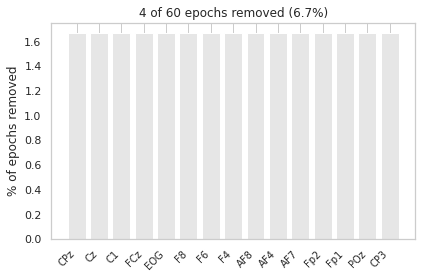

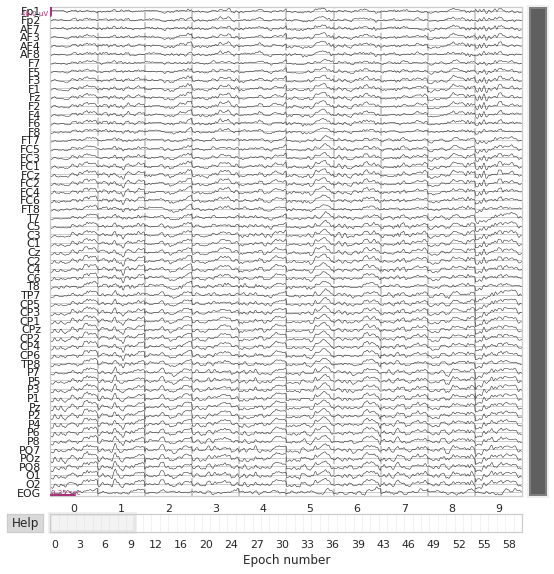

Overwriting existing file.


OSError: ignored

In [ ]:
preprocessing(fnames, info_filename=None,info="all")

## **Czytanie fif file**

In [ ]:
fnames_fif = glob.glob('gdrive/MyDrive/FIFY/S*-epo.fif')

In [ ]:
print(fnames_fif)

['gdrive/MyDrive/FIFY/S02_Sess01-epo.fif', 'gdrive/MyDrive/FIFY/S02_Sess02-epo.fif', 'gdrive/MyDrive/FIFY/S02_Sess03-epo.fif', 'gdrive/MyDrive/FIFY/S02_Sess04-epo.fif', 'gdrive/MyDrive/FIFY/S02_Sess05-epo.fif', 'gdrive/MyDrive/FIFY/S06_Sess01-epo.fif', 'gdrive/MyDrive/FIFY/S06_Sess02-epo.fif', 'gdrive/MyDrive/FIFY/S06_Sess03-epo.fif', 'gdrive/MyDrive/FIFY/S06_Sess04-epo.fif', 'gdrive/MyDrive/FIFY/S06_Sess05-epo.fif', 'gdrive/MyDrive/FIFY/S07_Sess01-epo.fif', 'gdrive/MyDrive/FIFY/S07_Sess02-epo.fif', 'gdrive/MyDrive/FIFY/S07_Sess03-epo.fif', 'gdrive/MyDrive/FIFY/S07_Sess04-epo.fif', 'gdrive/MyDrive/FIFY/S07_Sess05-epo.fif', 'gdrive/MyDrive/FIFY/S11_Sess01-epo.fif', 'gdrive/MyDrive/FIFY/S11_Sess02-epo.fif', 'gdrive/MyDrive/FIFY/S11_Sess03-epo.fif', 'gdrive/MyDrive/FIFY/S11_Sess04-epo.fif', 'gdrive/MyDrive/FIFY/S11_Sess05-epo.fif', 'gdrive/MyDrive/FIFY/S12_Sess01-epo.fif', 'gdrive/MyDrive/FIFY/S12_Sess02-epo.fif', 'gdrive/MyDrive/FIFY/S12_Sess03-epo.fif', 'gdrive/MyDrive/FIFY/S12_Sess04-e

#**Stworzenie dataframe**

*   Dla każdego pliku z fnames_fif (każdy raw to MNE Epoch z danymi z jednego segmentu z pliku .fif) tworzymy epochs z raw.
*   Dodajemy do dataframe (this_data_df) wraz z etykietami eventów.
*   Zamieniamy na EpochsArray.





In [ ]:
this_data_df = pd.DataFrame()

for file_fif in fnames_fif:
  print("\n", file_fif)
  epochs_readed = mne.read_epochs(file_fif)
  event_labels = epochs_readed.events[:,2] # get list of events (labes) for epochs in this session_subject
    
  this_data_df = pd.concat([this_data_df, pd.DataFrame({'eeg': epochs_readed, 'labels': event_labels})])
  print("\n", this_data_df)
this_data_df['eeg'] = this_data_df['eeg'].apply(lambda x: mne.EpochsArray(x.reshape(1, x.shape[0], x.shape[-1]), epochs_readed.info, tmin=epochs_readed.tmin))
print("\n", this_data_df)

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
0 projection items activated
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1 matching events found
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata


In [ ]:
data_df = copy.deepcopy(this_data_df) 

In [ ]:
data_df['eeg']

0     <EpochsArray |  1 events (all good), -0.1 - 0....
1     <EpochsArray |  1 events (all good), -0.1 - 0....
2     <EpochsArray |  1 events (all good), -0.1 - 0....
3     <EpochsArray |  1 events (all good), -0.1 - 0....
4     <EpochsArray |  1 events (all good), -0.1 - 0....
                            ...                        
95    <EpochsArray |  1 events (all good), -0.1 - 0....
96    <EpochsArray |  1 events (all good), -0.1 - 0....
97    <EpochsArray |  1 events (all good), -0.1 - 0....
98    <EpochsArray |  1 events (all good), -0.1 - 0....
99    <EpochsArray |  1 events (all good), -0.1 - 0....
Name: eeg, Length: 4337, dtype: object

In [ ]:
this_epochs_list = data_df['eeg'].to_list()

In [ ]:
this_epochs = mne.concatenate_epochs(this_epochs_list) # sklejamy epoki w jedną listę

Not setting metadata
4337 matching events found
No baseline correction applied


In [ ]:
# kopia, żeby móc sobie popatrzeć jak ilość wziętych kanałów wpływa na wyniki - 
# przed każdym kolejnym wywołaniem poniższej komórki trzeba wywołać to kopiowanie
epochs_list = copy.deepcopy(this_epochs) 

# **Przygotowanie danych z df do klasyfikacji**

#### 1. Sprawdzienie braków danych

In [ ]:
data_df.isnull().sum()

eeg       0
labels    0
dtype: int64

### **Funkcja evaluate_GS_model**

**Parametry:**
*   pipe - pipeline, przez który przechodzimy
*   X_train, y_train, X_test, y_test - dane
*   classifier_params - hiperparametry dla ewaluowanego modelu
*   pipeline_name
*   cv - typ kroswalidacji (StratifiedKFold 5 częściowy)

Definiujemy GridSearchCV refitujący na roc_auc.
Fitujemy model.
Przewidujemy testowe dane.
Wyciągamy średnią roc_auc z kroswalidacji.
Wybranie modelu z najlepszymi parametrami.
Zapisujemy wyniki do dataframe.




In [ ]:

def evaluate_GS_model(
    pipe,
    X_train, 
    y_train, 
    X_test, 
    y_test, 
    classifier_params,
    pipeline_name,
    cv=KFold(n_splits=5),
    predict_test = True,
    predict_train = True,
    ):
    
    # define grid search
    grid_search_model = GridSearchCV(
        pipe,
        classifier_params,
        cv=cv,
        scoring={"f1", "roc_auc", "accuracy", "precision", "recall"},
        refit="roc_auc",
        return_train_score=True,
        verbose=3,
    )

    # fit model
    grid_search_model.fit(X_train, y_train)

    # predict test data
    y_test_pred = grid_search_model.predict(X_test) if predict_test is True else None
    test_score = metrics.roc_auc_score(y_test, y_test_pred) if predict_test is True else None

    # predict train data
    y_train_pred = grid_search_model.predict(X_train) if predict_train is True else None
    train_score = metrics.roc_auc_score(y_train, y_train_pred) if predict_train is True else None 

    # extract mean cv scores
    mean_cv_score = grid_search_model.best_score_

    # extract splits scores
    # ta linijka wyciąga z cv_results, czyli z DF z wynikami wszystkich testowanych 
    # w GS parametrów scory na kolejnych splitach cross-validacji
    cv_results_df = pd.DataFrame(grid_search_model.cv_results_).iloc[[grid_search_model.best_index_]]
    cv_splits_scores_df = cv_results_df.filter(regex=r"split\d*_test_roc_auc").reset_index(drop=True) 

    # wyciąganie scorów na teście dla matryk zdefiniowanych w scoring
    metrics_results_df = cv_results_df.filter(regex=r"mean_test_*").reset_index(drop=True)


    # save results in dataframe
    this_result = pd.concat(
        [
            pd.DataFrame({
            "model_name": [pipe.steps[-1][0]],
            "pipeline_name": [pipeline_name],
            "train score": [train_score],
            "mean_cv_score": [mean_cv_score],
            "test_score": [test_score],
            "best_model": [grid_search_model.best_estimator_],
            "parameters": [grid_search_model.best_params_],
            }),
         cv_splits_scores_df,
         metrics_results_df,
        ],
    axis=1
    ) 

    return this_result

Definiujemy modele

In [ ]:
lr = ("lr", LogisticRegression())
lr_params = dict(
    lr__solver=["newton-cholesky", "sag", "saga"]
)

svc = ("svc", SVC())
svc_params = dict(
    svc__kernel=["linear", "rbf"],
    # jak C zwiększa się na 10 GS zaczyna działać bardzo bardzo wolno, dlatego tymczasowo zmieniam na C do 1
    #svr__C=[0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10, 20, 50, 100],
    #svr__epsilon=[0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 2, 5, 10],
    svc__C=[0.00001, 0.0001, 0.001, 0.01, 0.1, 1]
)

knn = ("knn", KNeighborsClassifier())
knn_params = dict(
    knn__n_neighbors=np.arange(1,50,2),
    knn__weights=['uniform', 'distance']
)

dt = ("dt", DecisionTreeClassifier())
dt_params = dict(
    dt__max_depth = np.arange(1,20,2)
)

estimators = [
    (lr, lr_params),
    (svc, svc_params),
    (knn, knn_params),
    (dt, dt_params)
]

# **Tworzenie modeli w pipeline**


#### 2. Tworzenie X i y

* Za **y** przyjmujemy etykiety (**0** gdy P300 wystąpiło - wyświetlony w feedbacku element był inny od spodziewanego lub **1** w przeciwnym wypadku)
* Dla **X** wybieramy kanały: 'Cz', 'Fz', 'Pz', 'PO7', 'PO8'
* Dla **X** wybieramy time window 150 - 450 ms
* Uśredniamy timepointy na każdym z kanałów

In [ ]:
y = data_df['labels']

In [ ]:
y


0     1
1     1
2     0
3     0
4     0
     ..
95    1
96    0
97    0
98    0
99    1
Name: labels, Length: 4337, dtype: int32

In [ ]:
picks = ['Cz', 'Fz', 'Pz', 'PO7', 'PO8']
epochs_list = [epoch.pick_channels(ch_names=picks, ordered=True) for epoch in data_df['eeg']]
print("\nEpochs list after channel picks:", epochs_list[0])

tmin = 0.15
tmax = 0.45

epochs_list = [epoch.crop(tmin=tmin, tmax=tmax) for epoch in data_df['eeg']]
print("\nEpochs list after time crop:", epochs_list[0])



Epochs list after channel picks: <EpochsArray |  1 events (all good), -0.1 - 0.6 sec, baseline off, ~40 kB, data loaded,
 '1': 1>

Epochs list after time crop: <EpochsArray |  1 events (all good), 0.15 - 0.45 sec, baseline off, ~37 kB, data loaded,
 '1': 1>


In [ ]:
X = np.array([epoch.get_data() for epoch in epochs_list])
X = np.squeeze(X) # usuwa wymiary o rozmiarze 1

print(X.shape) #punkt danych x ? x channels x timepoints

(4337, 5, 61)


In [ ]:
X = np.mean(X, axis=-1)

print(X.shape)
print(y.shape)

(4337, 5)
(4337,)


#### 3. Train-test split

In [ ]:
test_size = 0.2
random_state = 42

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    X, 
    y, 
    test_size=test_size, 
    random_state=random_state
)

In [ ]:
results_df = pd.DataFrame()

##StandardScaler

Definiujemy kroki pipelinu

In [ ]:
pipeline_name = "Pipeline_base"
base_steps = [
      ('scaler', StandardScaler()), 
]

Ewaluacja Pipeline

In [ ]:
for (estimator, params) in estimators:
  print(f"Rating {estimator} \n")

  # create pipeline from base steps list and estimator
  pipe = Pipeline(base_steps + [estimator])

  # enter to grid search
  this_results = evaluate_GS_model(
      pipe,
      X_train,
      y_train,
      X_test,
      y_test,
      params,
      pipeline_name = pipeline_name,
      predict_test = True,
      predict_train = True,
      cv=StratifiedKFold(n_splits=5) # StratifiedKFold rozdziela dane zachowując proporcję klas pomiędzy splitami
  )

  results_df = results_df.append(this_results)


Rating ('lr', LogisticRegression()) 

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.0s
[CV 2/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.0s
[CV 3/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.0s
[CV 4/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.0s
[CV 5/5] END lr__solver=newton-cholesky; accuracy: (tr

In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('scaler', StandardScaler()), ('dt', DecisionTreeClassifier())])

In [ ]:
results_df

,model_name,pipeline_name,train score,mean_cv_score,test_score,best_model,parameters,split0_test_roc_auc,split1_test_roc_auc,split2_test_roc_auc,split3_test_roc_auc,split4_test_roc_auc,mean_test_precision,mean_test_recall,mean_test_roc_auc,mean_test_f1,mean_test_accuracy
0,lr,Pipeline_base,0.519725,0.645981,0.516839,"(StandardScaler(), LogisticRegression(solver='...",{'lr__solver': 'sag'},0.650864,0.643885,0.629596,0.678594,0.626966,0.700946,0.961311,0.645981,0.810723,0.688958
0,svc,Pipeline_base,0.500000,0.630470,0.500000,"(StandardScaler(), SVC(C=0.0001, kernel='linea...","{'svc__C': 0.0001, 'svc__kernel': 'linear'}",0.611793,0.632944,0.611558,0.677218,0.618838,0.692995,1.000000,0.630470,0.818662,0.692995
0,knn,Pipeline_base,1.000000,0.605846,0.516443,"(StandardScaler(), KNeighborsClassifier(n_neig...","{'knn__n_neighbors': 49, 'knn__weights': 'dist...",0.613901,0.605448,0.585634,0.672396,0.551849,0.699032,0.970882,0.605846,0.812811,0.690112
0,dt,Pipeline_base,0.590333,0.588002,0.532782,"(StandardScaler(), DecisionTreeClassifier(max_...",{'dt__max_depth': 7},0.635945,0.581506,0.569207,0.595727,0.557624,0.700489,0.927196,0.588002,0.797938,0.674829


###Wykres z wynikami

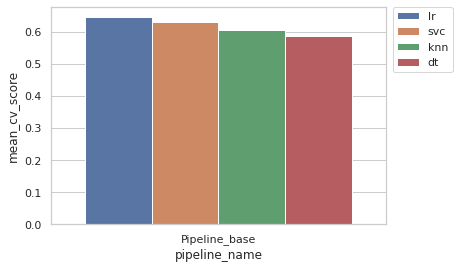

In [ ]:
fig = sns.barplot(
    data=results_df,
    x="pipeline_name",
    y="mean_cv_score",
    hue="model_name"
)

plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.show()



---



# **Modele z feature extraction**


### 1. Podstawowy pre-processing


Definiowanie kroków

Macie dużo danych - przy tak dużej ilości danych nie musicie się bać tak bardzo overfittingu. Mean apmplitude na time window na kilku elektrodach był dobrym punktem wyjścia, ale chciałabym, żebyście zobaczyły, ze inne rzeczy działają lepiej (a co za tym idzie - ile informacji tracimy, jak robimy proste mean amplitude na time winow i mamy dosłownie 1 albo kilka features). Drubcie ten pipeline z PCA w taki sposów:
  - kilkanaście (do 20 kanałów): **'Cz', 'Fz', 'Pz', 'PO7', 'PO8', 'FCz', 'CPz', 'P4', 'P3', 'P7', 'P8', 'FP2', 'FP1', 'C3', 'C4', 'FC3', 'FC4'**
  - time window: **150 - 450 ms**
  - decymacja (żeby nie przegiąć z features, ale nie musieć robić mean amplitude;
  - scaler

I to wsadźcie do klasyfikatora :)

Wygodniej też Wam będzie na samym początku skonkatenować epoki - będzie się wtedy wygodniej pre-processowało dane


Odnośnie decymacji: Jednym ze sposobów zmiejszenia ilości features jest decymacja, czyli wzięcie co N elementu jakiejś sekwencji (w naszym przypadku co N timepoints). Działą to trochę jak taki downsampling. Dzięki temu mamy mniej timepoints = mniej features.



In [ ]:
data_df = copy.deepcopy(this_data_df) 

In [ ]:
data_df

,eeg,labels
0,"<EpochsArray | 1 events (all good), -0.1 - 0....",1
1,"<EpochsArray | 1 events (all good), -0.1 - 0....",1
2,"<EpochsArray | 1 events (all good), -0.1 - 0....",0
3,"<EpochsArray | 1 events (all good), -0.1 - 0....",0
4,"<EpochsArray | 1 events (all good), -0.1 - 0....",0
...,...,...
95,"<EpochsArray | 1 events (all good), -0.1 - 0....",1
96,"<EpochsArray | 1 events (all good), -0.1 - 0....",0
97,"<EpochsArray | 1 events (all good), -0.1 - 0....",0
98,"<EpochsArray | 1 events (all good), -0.1 - 0....",0


In [ ]:
this_epochs_list = data_df['eeg'].to_list()

In [ ]:
this_epochs = mne.concatenate_epochs(this_epochs_list) # sklejamy epoki w jedną listę

Not setting metadata
4337 matching events found
No baseline correction applied


In [ ]:
# kopia, żeby móc sobie popatrzeć jak ilość wziętych kanałów wpływa na wyniki - 
# przed każdym kolejnym wywołaniem poniższej komórki trzeba wywołać to kopiowanie
epochs = copy.deepcopy(this_epochs) 

Przygotowanie danych:
  - kanały: **'Cz', 'Fz', 'Pz', 'PO7', 'PO8', 'FCz', 'CPz', 'P4', 'P3', 'P7', 'P8', 'FP2', 'FP1', 'C3', 'C4', 'FC3', 'FC4'**
  - time window: **150 - 450 ms**
  - decymacja (zamiast uśredniania amplitudy)

In [ ]:
# channels
picks = ['Cz', 'Fz', 'Pz', 'PO7', 'PO8', 'FCz', 'CPz', 'P4', 'P3', 'P7', 'P8', 'Fp2', 'Fp1', 'C3', 'C4', 'FC3', 'FC4']
epochs = epochs.pick_channels(ch_names=picks, ordered=True)
print("\nEpochs list after channel picks:", epochs.info)

#time window
tmin = 0.15
tmax = 0.45

epochs = epochs.crop(tmin=tmin, tmax=tmax)
print("\nEpochs list after time crop:", epochs)

# decimate
# https://mne.tools/stable/generated/mne.Epochs.html#mne.Epochs.decimate
epochs = epochs.decimate(5)

print("\nEpochs list after decimation:", epochs)


Epochs list after channel picks: <Info | 10 non-empty values
 bads: []
 ch_names: Cz, Fz, Pz, PO7, PO8, FCz, CPz, P4, P3, P7, P8, Fp2, Fp1, C3, ...
 chs: 17 EEG
 custom_ref_applied: False
 dig: 59 items (3 Cardinal, 56 EEG)
 file_id: 4 items (dict)
 highpass: 0.1 Hz
 lowpass: 25.0 Hz
 meas_date: unspecified
 meas_id: 4 items (dict)
 nchan: 17
 projs: []
 sfreq: 200.0 Hz
>

Epochs list after time crop: <EpochsArray |  4337 events (all good), 0.15 - 0.45 sec, baseline off, ~34.4 MB, data loaded,
 '1': 4337>

Epochs list after decimation: <EpochsArray |  4337 events (all good), 0.15 - 0.45 sec, baseline off, ~7.4 MB, data loaded,
 '1': 4337>


In [ ]:
X = epochs.get_data()
X.shape

(4337, 17, 13)

In [ ]:
y = data_df.labels.to_list()

In [ ]:
test_size = 0.2
random_state = 42

X_train, X_test, y_train, y_test = train_test_split(
    X, 
    y, 
    test_size=test_size, 
    random_state=random_state,
    stratify=y # zachowuje balans klas
)

Po powyższej komórce macie ogarnięte dane od strony MNE: wyciągnięte kanały,. time-winow, decymacja. Teraz możecie zrobić pipeline. 

UnsupervisedSpatialFilter jest typu Transforms - implementuje metody fit() i transform() więc może być częścią pipeline :)

In [ ]:
pipeline_name = f"SF_PCA"

base_steps = [
    ('spatial_filter', UnsupervisedSpatialFilter(PCA(4), average=False)), # powstaną 4 nowe kanały z 17
    ('vectorizer', Vectorizer()), # reshape ze struktury 3D na strukturę 2D
    ('scaler', StandardScaler()), 
    # ('feature_extraction',  PCA(2)) 
]

pipeline_params = dict()

In [ ]:
for (estimator, params) in estimators:
    print(f"Rating {estimator} \n")

  # create pipeline from base steps list and estimator
    pipe = Pipeline(base_steps + [estimator])

    parameters = params.copy() 
    parameters.update(pipeline_params)

    # enter to grid search
    this_results = evaluate_GS_model(
        pipe,
        X_train,
        y_train,
        X_test,
        y_test,
        parameters,
        pipeline_name = pipeline_name,
        predict_test = True,
        predict_train = True,
        cv=StratifiedKFold(n_splits=5)
    )

    results_df = results_df.append(this_results)

Rating ('lr', LogisticRegression()) 

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.2s
[CV 2/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.1s
[CV 3/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.2s
[CV 4/5] END lr__solver=newton-cholesky; accuracy: (train=nan, test=nan) f1: (train=nan, test=nan) precision: (train=nan, test=nan) recall: (train=nan, test=nan) roc_auc: (train=nan, test=nan) total time=   0.2s
[CV 5/5] END lr__solver=newton-cholesky; accuracy: (tr

In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('spatial_filter',
                 UnsupervisedSpatialFilter({'average': False, 'estimator': PCA(n_components=4)})),
                ('vectorizer',
                 <mne.decoding.transformer.Vectorizer object at 0x7f5cbf2c2580>),
                ('scaler', StandardScaler()),
                ('dt', DecisionTreeClassifier())])

In [ ]:
results_df

,model_name,pipeline_name,train score,mean_cv_score,test_score,best_model,parameters,split0_test_roc_auc,split1_test_roc_auc,split2_test_roc_auc,split3_test_roc_auc,split4_test_roc_auc,mean_test_precision,mean_test_recall,mean_test_roc_auc,mean_test_f1,mean_test_accuracy
0,lr,Pipeline_base,0.519725,0.645981,0.516839,"(StandardScaler(), LogisticRegression(solver='...",{'lr__solver': 'sag'},0.650864,0.643885,0.629596,0.678594,0.626966,0.700946,0.961311,0.645981,0.810723,0.688958
0,svc,Pipeline_base,0.500000,0.630470,0.500000,"(StandardScaler(), SVC(C=0.0001, kernel='linea...","{'svc__C': 0.0001, 'svc__kernel': 'linear'}",0.611793,0.632944,0.611558,0.677218,0.618838,0.692995,1.000000,0.630470,0.818662,0.692995
0,knn,Pipeline_base,1.000000,0.605846,0.516443,"(StandardScaler(), KNeighborsClassifier(n_neig...","{'knn__n_neighbors': 49, 'knn__weights': 'dist...",0.613901,0.605448,0.585634,0.672396,0.551849,0.699032,0.970882,0.605846,0.812811,0.690112
0,dt,Pipeline_base,0.590333,0.588002,0.532782,"(StandardScaler(), DecisionTreeClassifier(max_...",{'dt__max_depth': 7},0.635945,0.581506,0.569207,0.595727,0.557624,0.700489,0.927196,0.588002,0.797938,0.674829
0,lr,SF_PCA,0.585144,0.673702,0.579241,"(UnsupervisedSpatialFilter({'average': False, ...",{'lr__solver': 'saga'},0.659920,0.673150,0.652076,0.684119,0.699247,0.729421,0.924500,0.673702,0.815418,0.710868
0,svc,SF_PCA,0.500000,0.710967,0.500000,"(UnsupervisedSpatialFilter({'average': False, ...","{'svc__C': 0.1, 'svc__kernel': 'rbf'}",0.703865,0.701645,0.691683,0.728261,0.729382,0.690977,1.000000,0.710967,0.817252,0.690977
0,knn,SF_PCA,1.000000,0.692670,0.508495,"(UnsupervisedSpatialFilter({'average': False, ...","{'knn__n_neighbors': 49, 'knn__weights': 'dist...",0.683732,0.675876,0.703724,0.707132,0.692886,0.693021,0.998332,0.692670,0.818120,0.693283
0,dt,SF_PCA,0.568032,0.613491,0.535659,"(UnsupervisedSpatialFilter({'average': False, ...",{'dt__max_depth': 3},0.626903,0.636020,0.579774,0.616056,0.608701,0.707044,0.937826,0.613491,0.806110,0.688381


###Wykres z wynikami

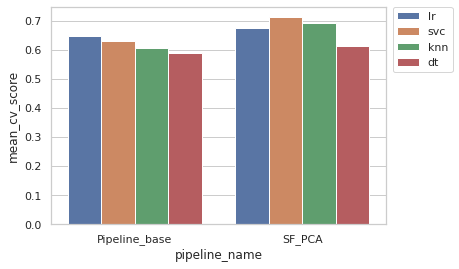

In [ ]:
fig = sns.barplot(
    data=results_df,
    x="pipeline_name",
    y="mean_cv_score",
    hue="model_name"
)

plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.show()

---